In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
gauge_df = pd.read_csv('gauge.csv', index_col=1)
gauge_df.drop('Year', axis=1, inplace=True)
gauge_df

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
Week,,,,,,,,,,,,,,,,,,,,,
1,20.8,25.6,9.8,8.6,21.0,13.2,4.8,45.6,43.0,18.6,...,22.4,27.6,30.0,31.8,50.7,6.2,42.6,31.6,10.0,22.0
2,54.0,0.2,14.2,21.4,74.2,2.6,40.6,37.2,0.0,2.8,...,1.6,45.2,2.4,40.6,49.2,0.0,1.0,50.8,48.0,0.0
3,149.6,145.2,92.8,72.6,177.1,35.2,67.2,96.0,NaN,80.2,...,32.2,128.2,81.4,133.0,157.3,17.8,57.0,169.8,74.6,70.6
4,120.0,93.0,124.6,74.6,110.9,117.2,81.8,84.2,81.0,106.6,...,123.4,78.0,92.8,83.8,87.6,98.2,78.0,77.4,110.0,117.4
5,46.0,2.4,16.6,69.0,91.7,13.8,67.8,86.6,4.6,17.4,...,7.6,54.0,23.0,78.4,98.3,11.4,32.6,37.0,78.6,9.6
6,62.0,12.2,35.0,63.8,40.6,51.6,36.2,23.4,28.6,110.2,...,58.4,30.0,NaN,NaN,41.0,18.4,27.8,51.2,83.6,7.8
7,23.6,8.2,20.0,14.8,23.8,9.2,19.0,10.2,19.0,7.8,...,20.6,10.0,NaN,NaN,12.2,2.4,12.2,11.8,28.2,7.2
8,59.4,NaN,41.6,57.8,48.2,38.8,34.8,70.2,114.8,17.4,...,65.6,63.2,NaN,75.4,64.4,23.4,95.4,52.0,39.0,33.2
9,57.2,NaN,52.4,68.0,66.8,99.6,51.4,85.0,97.2,47.6,...,79.2,101.4,NaN,54.4,51.9,93.6,67.4,70.2,64.6,37.4


In [3]:
weeks = ['13', '15', '16', '17', '18',
'19', '20', '21', '22', '23',
'24', '26', '28', '29', '31',
'32', '33', '35', '36', '37',
'38', '39', '41', '44', '45',
'46', '47', '48', '49', '50',
'51']
weeksint = list(map(int, weeks))

In [4]:
radars = pd.read_csv('radars_withoutzero.csv', index_col=('lat', 'long'))
radars.head(n=10)

13         15         16         17         18         19  \
lat long                                                                     
0   0     72.294636  45.855110  11.555313  58.455189  13.455605  12.315153   
    1     66.840412  48.700857  10.447831  70.463169  14.657457   8.156273   
    2     83.611426  47.329886  10.981148  56.940418  13.143666   9.930907   
    3     85.075782  56.994606  12.083639  54.885893  11.120173  21.864765   
    4     84.071118  58.285694  12.180566  45.201168  11.000099  21.605478   
    5     81.000618  62.580485  12.906918  63.381817  10.189529  14.932759   
    6     75.050963  47.807548  13.853209  45.000145  11.312839  18.564631   
    7     69.622593  36.806604  15.173553  44.059012   6.999031  24.044255   
    8     75.415726  44.439799  21.221386  41.478677   8.522376  20.535150   
    9     80.799770  38.762127  14.196516  42.314822  10.112614  22.923202   

                 20         21        22         23    ...           39  \
lat long                                               ...                
0   0     22.446733  33.734686  4.518157  29.707207    ...     3.454643   
    1     27.562347  37.508739  4.528953  28.870022    ...     3.425111   
    2     33.860542  39.010331  5.404231  36.114737    ...     2.507637   
    3     38.093529  43.022287  6.687292  31.489770    ...     2.968954   
    4     39.206432  43.331180  6.727096  30.539226    ...     2.857295   
    5     26.669373  38.914828  5.673334  35.596037    ...     2.914037   
    6     33.853437  41.436309  5.093495  21.394368    ...     3.529375   
    7     30.299419  33.371672  5.920663  24.174678    ...     2.417975   
    8     36.984285  33.036344  6.848641  19.191810    ...     2.663142   
    9     39.875694  30.630790  7.171367  16.993073    ...     3.568752   

                 41         44         45         46         47         48  \
lat long                                                                     
0   0     27.415225  24.765249  74.342486  58.404235  21.351817  20.594985   
    1     27.389223  36.585670  73.170429  58.305703  23.131464  18.431464   
    2     26.342005  26.940263  72.568766  54.546573  17.527366  20.200261   
    3     30.875726  27.699918  84.671733  59.378169  16.759426  21.481097   
    4     31.569345  36.670290  87.311255  63.802085  17.443937  22.660412   
    5     26.542776  27.299325  82.120231  59.683283  13.898443  22.387424   
    6     29.983836  27.044286  83.765618  65.893522  14.757252  25.541144   
    7     31.005859  22.941232  89.237978  63.075915  12.790094  22.865527   
    8     27.983706  32.419345  96.345365  67.570239  10.169690  23.968217   
    9     26.059206  29.121352  99.639398  62.568772  13.347432  30.898068   

                 49         50        51  
lat long                                  
0   0     27.730778  23.828046  2.647047  
    1     26.798295  26.875146  3.281278  
    2     28.595661  41.048792  2.690293  
    3     31.845850  42.256502  2.423741  
    4     33.322246  44.921599  2.349027  
    5     32.407635  33.299733  2.783190  
    6     39.933174  33.838313  2.784754  
    7     31.439534  24.647667  3.267726  
    8     32.906297  27.838460  2.526362  
    9     33.515732  23.999644  2.346348  

[10 rows x 31 columns]

In [5]:
radars.as_matrix()

array([[72.29463559, 45.85510988, 11.55531293, ..., 27.73077842,
        23.82804566,  2.64704728],
       [66.84041188, 48.70085654, 10.44783132, ..., 26.79829519,
        26.87514552,  3.28127822],
       [83.611426  , 47.32988626, 10.98114837, ..., 28.59566132,
        41.04879177,  2.69029312],
       ...,
       [18.87338421, 27.70918519, 34.79874871, ...,  4.85541479,
        46.7983737 ,  1.93377499],
       [20.41106685, 28.51925955, 36.8096381 , ...,  4.83251819,
        45.83684308,  2.23887639],
       [19.29473613, 25.96905287, 37.41349062, ...,  4.62018384,
        48.05801833,  2.00972925]])

In [6]:
stations_dict={0: (222, 248), 1: (123, 249), 2: (218, 255), 3: (238, 252), 4: (214, 237), 5: (159, 245), 6: (245, 231), 7: (202, 214), 8: None, 9: (190, 257), 10: (130, 274), 11: (183, 254), 12: (217, 218), 13: (201, 257), 14: None, 15: (167, 244), 16: (210, 254), 17: (187, 208), 18: None, 19: (186, 230), 20: (146, 229), 21: (178, 230), 22: (202, 234), 23: (234, 232), 24: (161, 226), 25: (180, 241), 26: (135, 229), 27: (183, 250), 28: (169, 260), 29: (201, 243), 30: (198, 249), 31: (143, 238), 32: (171, 263), 33: (141, 254), 34: (209, 242), 35: (227, 224), 36: (193, 257), 37: (149, 227), 38: (231, 240), 39: None, 40: (202, 265), 41: (194, 228), 42: (138, 205), 43: (185, 213), 44: None, 45: (158, 264), 46: (106, 259), 47: (188, 241), 48: (239, 213), 49: (163, 299)}

88012
(172, 183)
88012
88012
(172, 183)
88491
(171, 184)
98565
(165, 205)
b


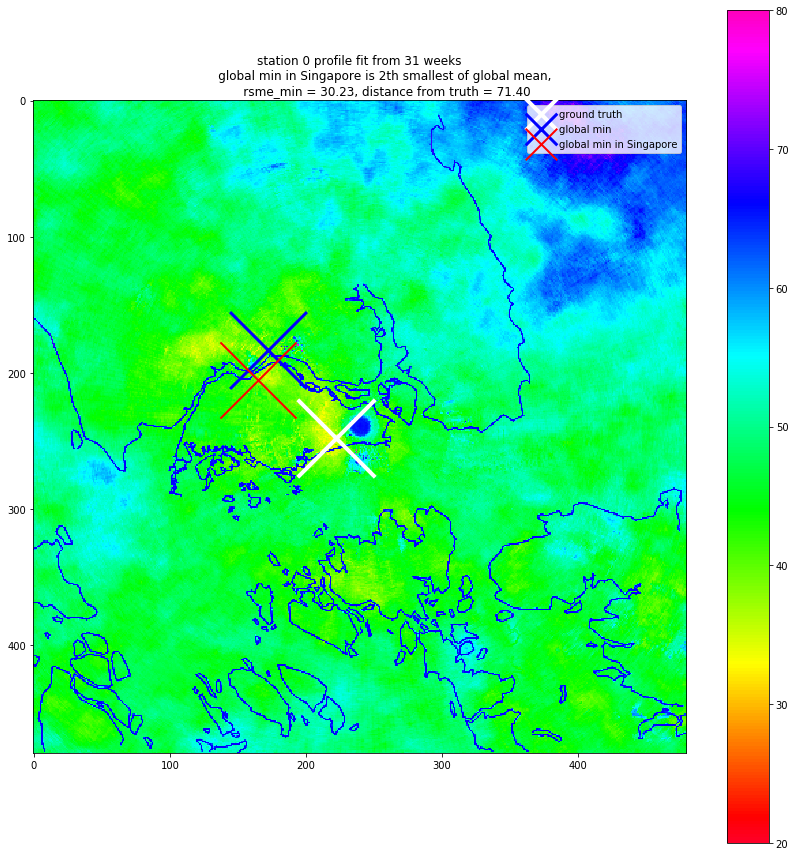

(0, 1000000, 98565, 30.23408942905391, False, 2)
123483
(123, 257)
123483
123483
(123, 257)
b


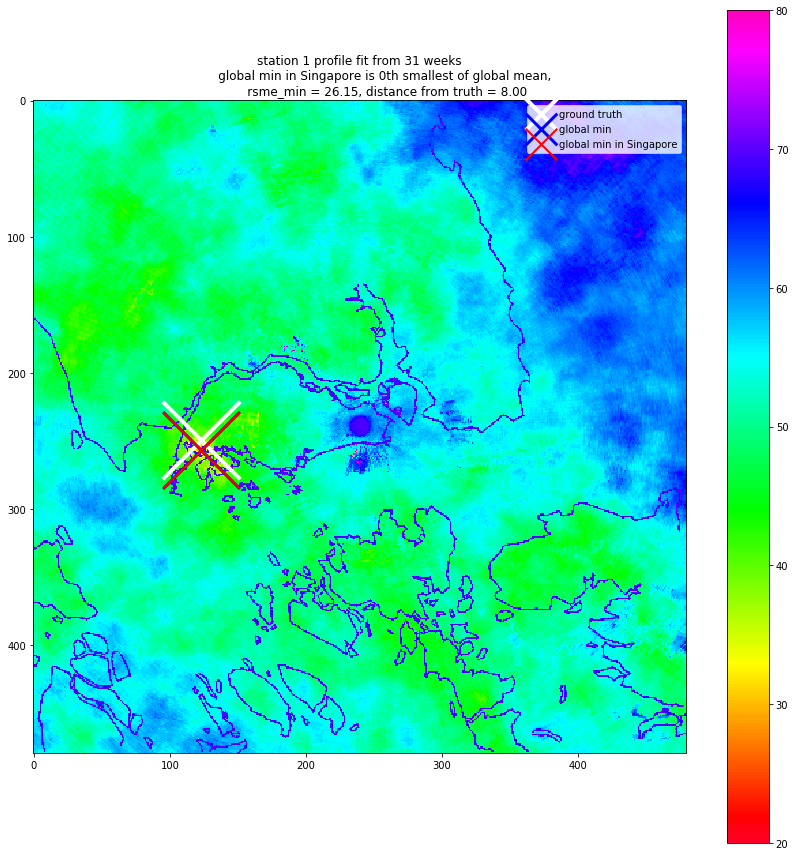

(1, 1000000, 123483, 26.15360146133119, False, 0)
123099
(219, 256)
123099
123099
(219, 256)
c


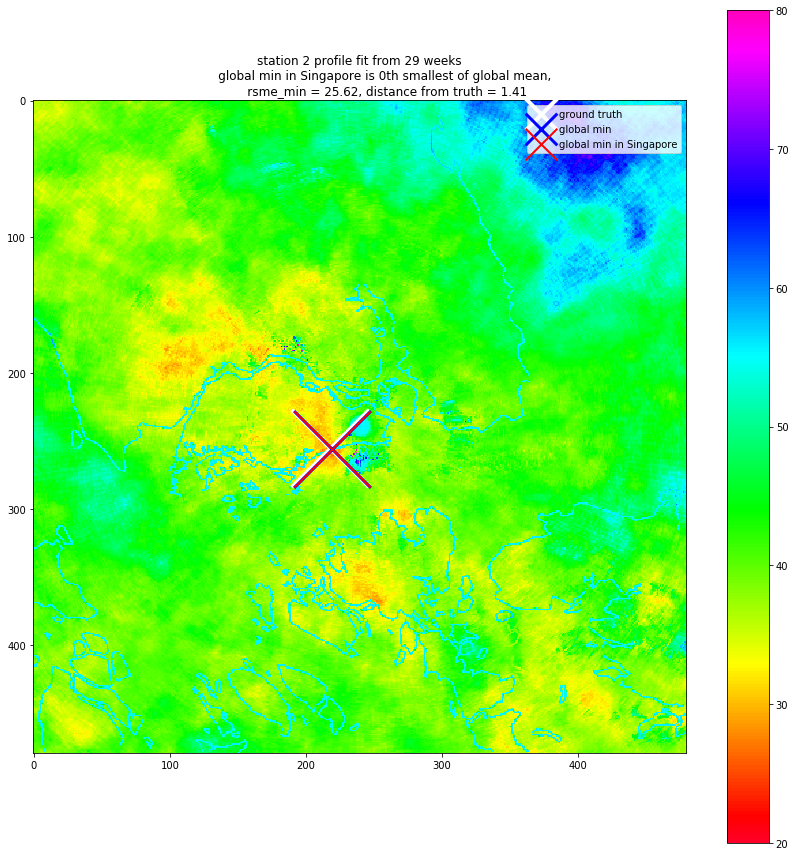

(2, 1000000, 123099, 25.62340856840756, True, 0)
104385
(225, 217)
104385
104385
(225, 217)
c


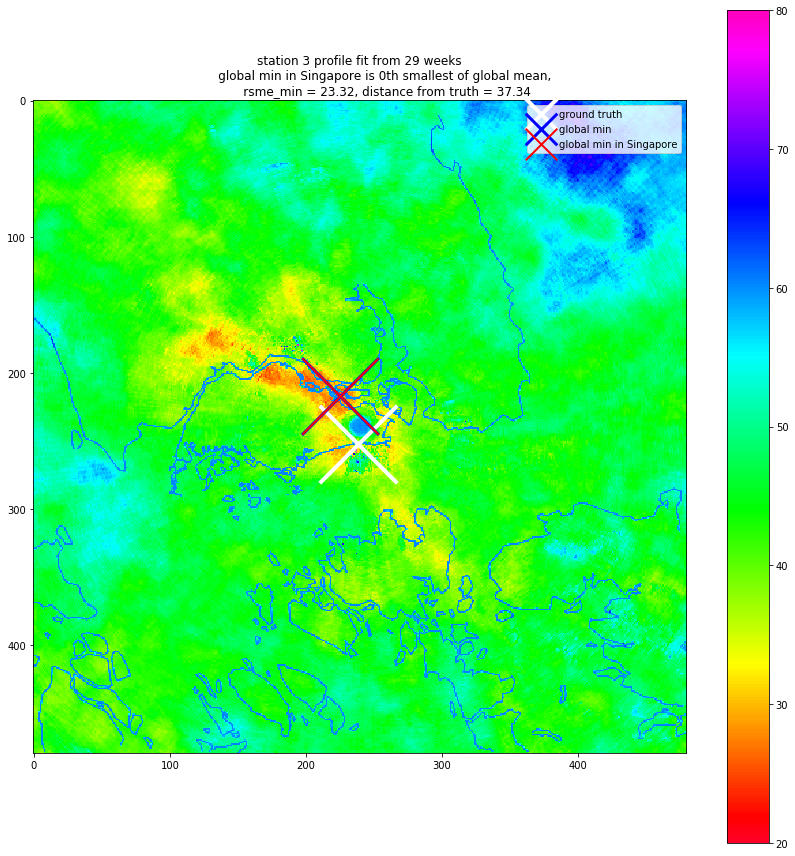

(3, 1000000, 104385, 23.316653926036135, True, 0)
88491
(171, 184)
88491
88491
(171, 184)
88012
(172, 183)
119680
(160, 249)
b


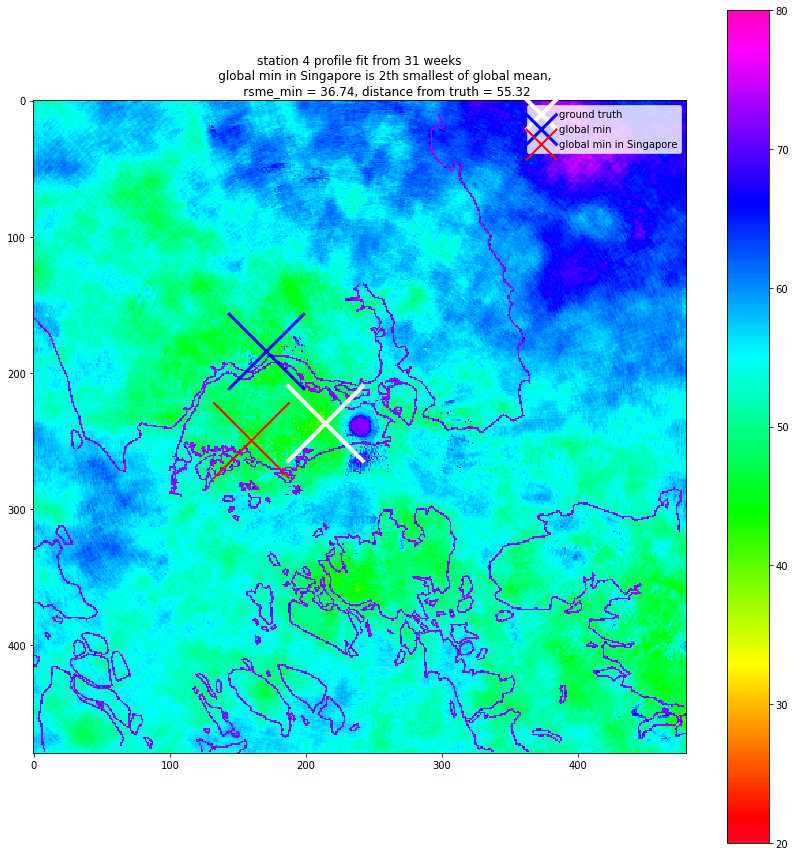

(4, 1000000, 119680, 36.736546178283454, False, 2)
119679
(159, 249)
119679
119679
(159, 249)
b


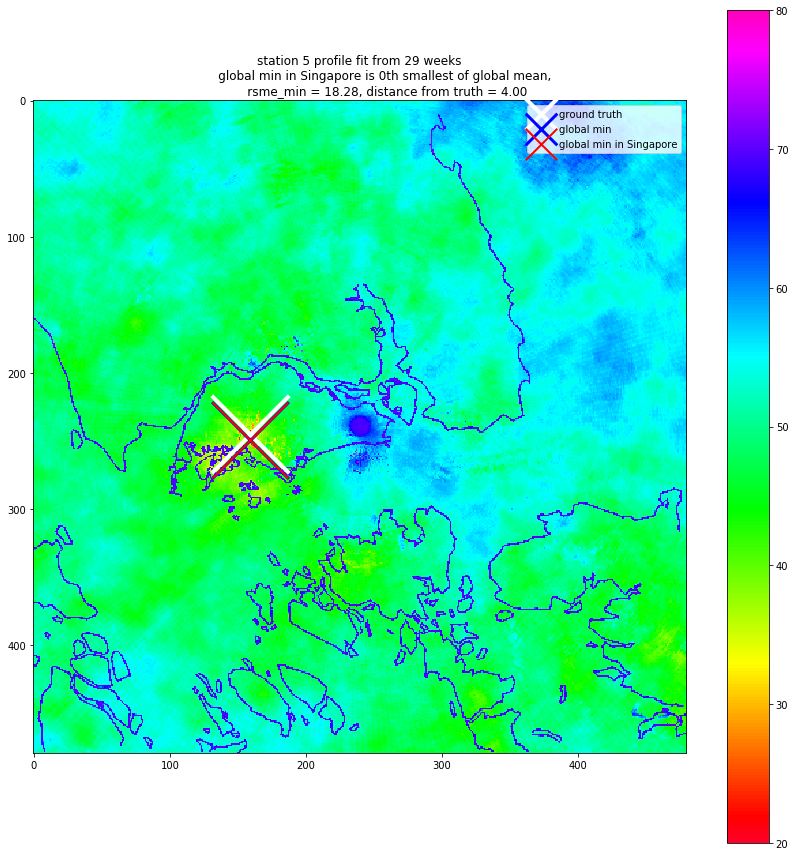

(5, 1000000, 119679, 18.279831889484154, True, 0)
100061
(221, 208)
100061
100061
(221, 208)
c


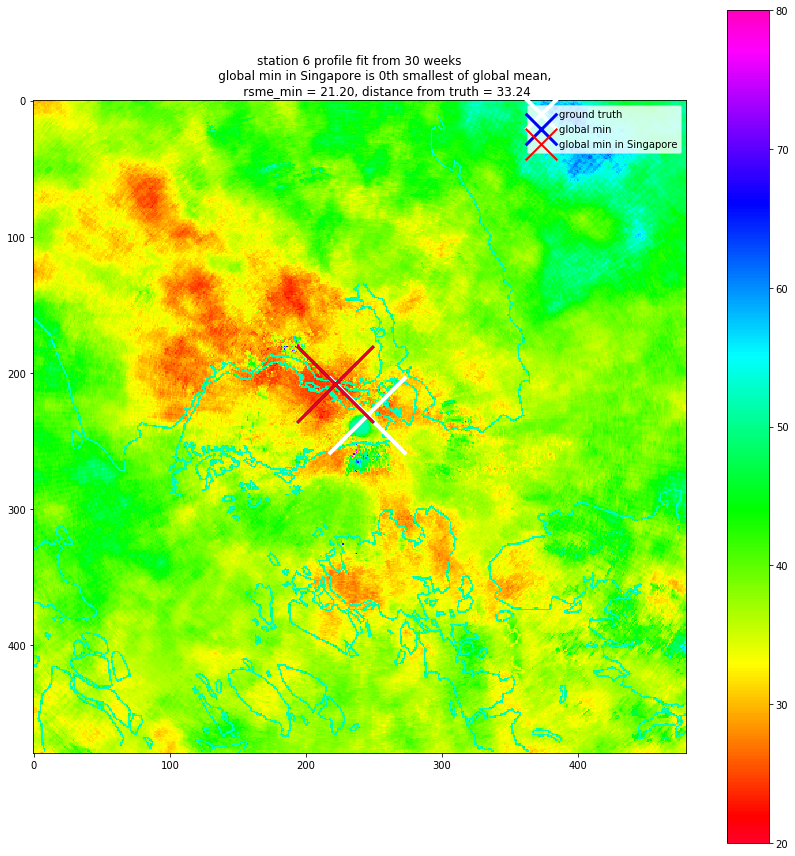

(6, 1000000, 100061, 21.195118110048707, True, 0)
95211
(171, 198)
95211
95211
(171, 198)
c


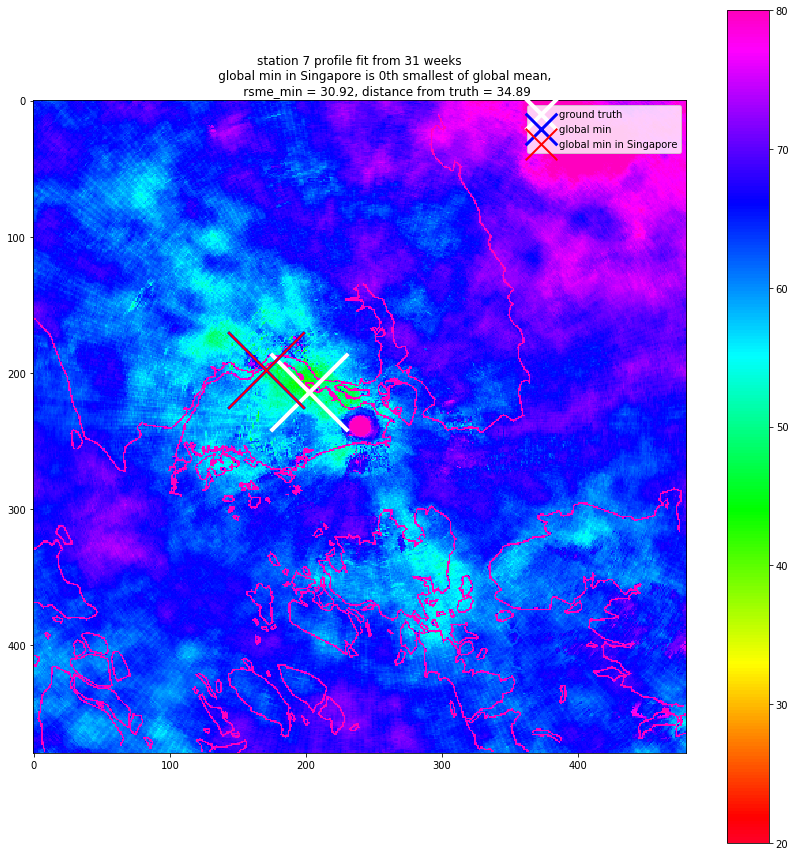

(7, 1000000, 95211, 30.91528195702736, False, 0)
123483
(123, 257)
123483
123483
(123, 257)
b


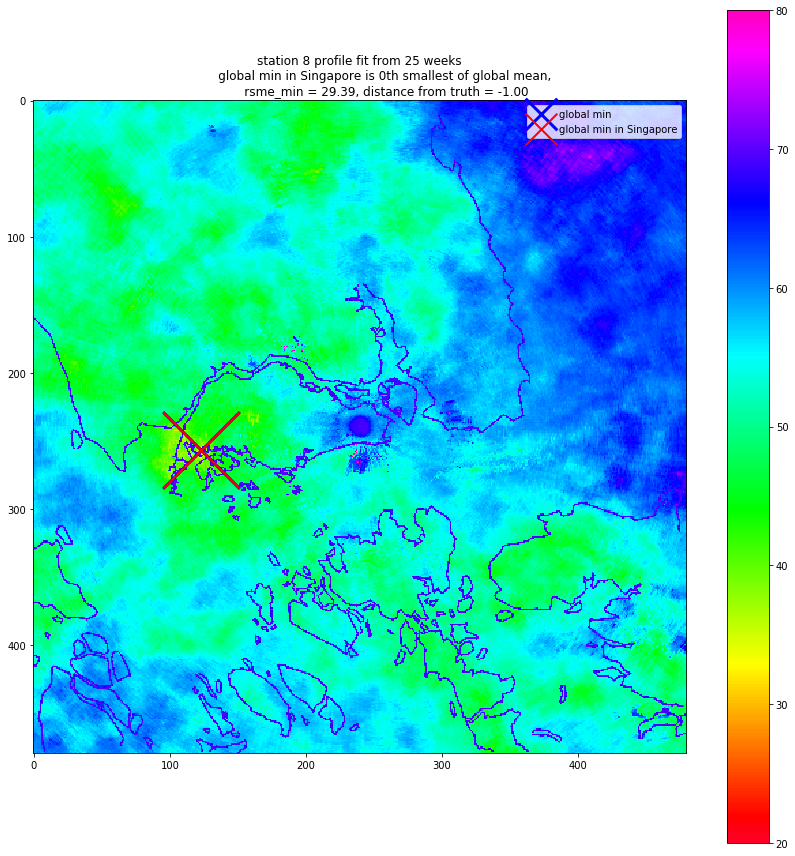

(8, 1000000, 123483, 29.385467246110036, True, 0)
126421
(181, 263)
126421
126421
(181, 263)
c


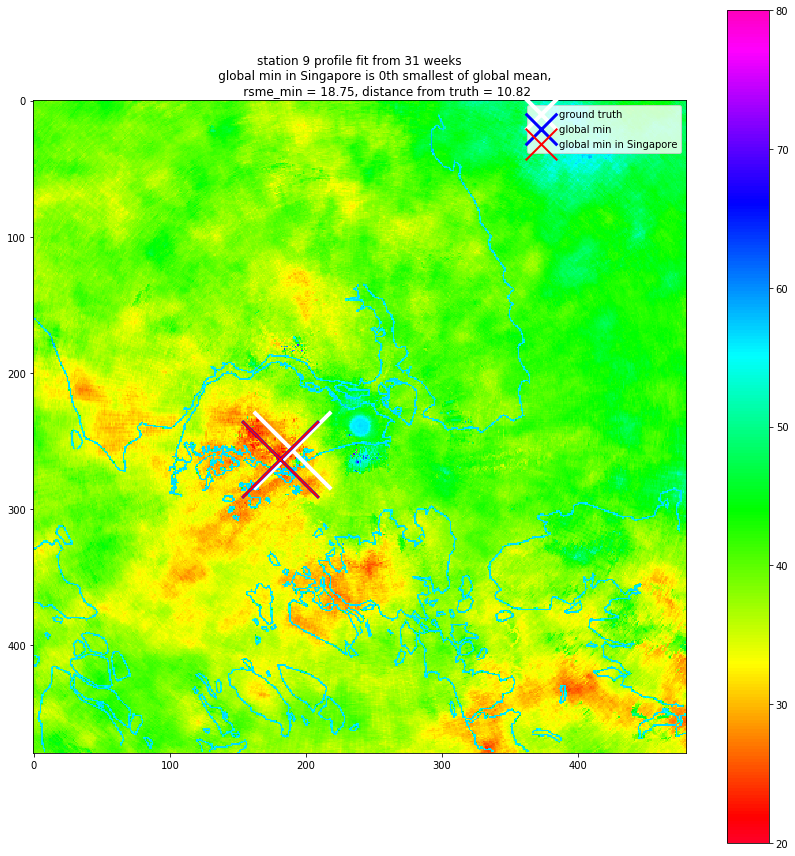

(9, 1000000, 126421, 18.745743147141276, False, 0)
132613
(133, 276)
132613
132613
(133, 276)
b


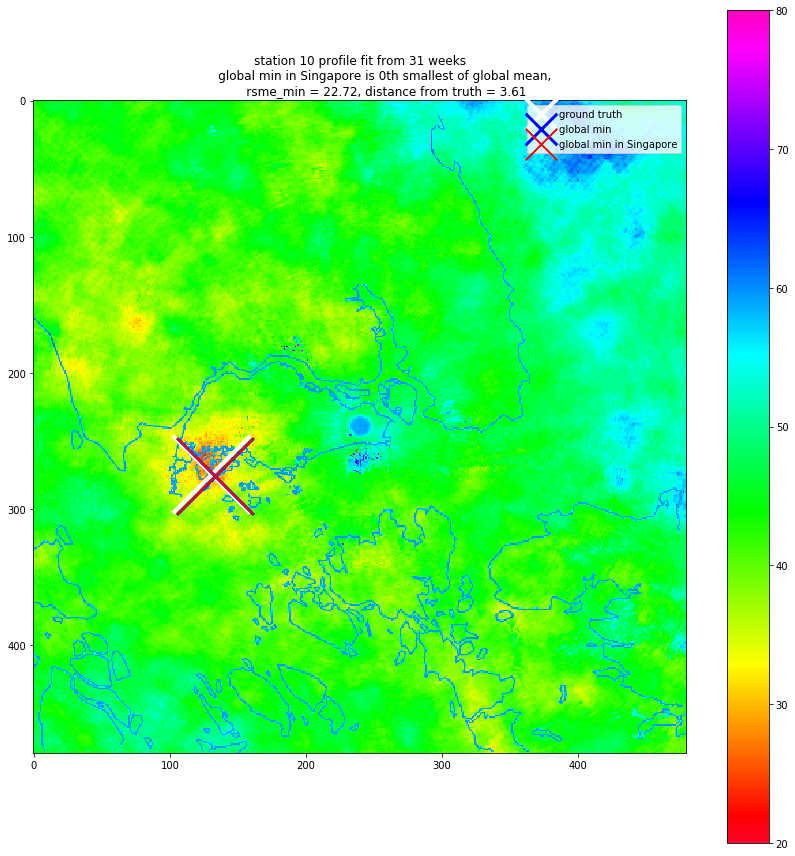

(10, 1000000, 132613, 22.718058261789952, False, 0)
116799
(159, 243)
116799
116799
(159, 243)
b


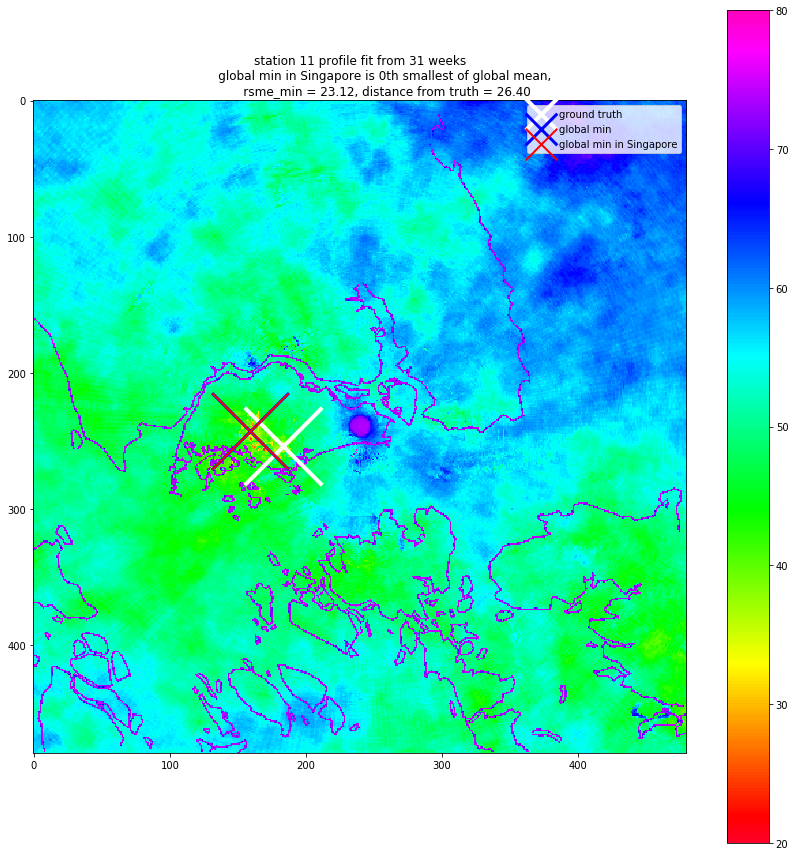

(11, 1000000, 116799, 23.116617680945932, False, 0)
94732
(172, 197)
94732
94732
(172, 197)
c


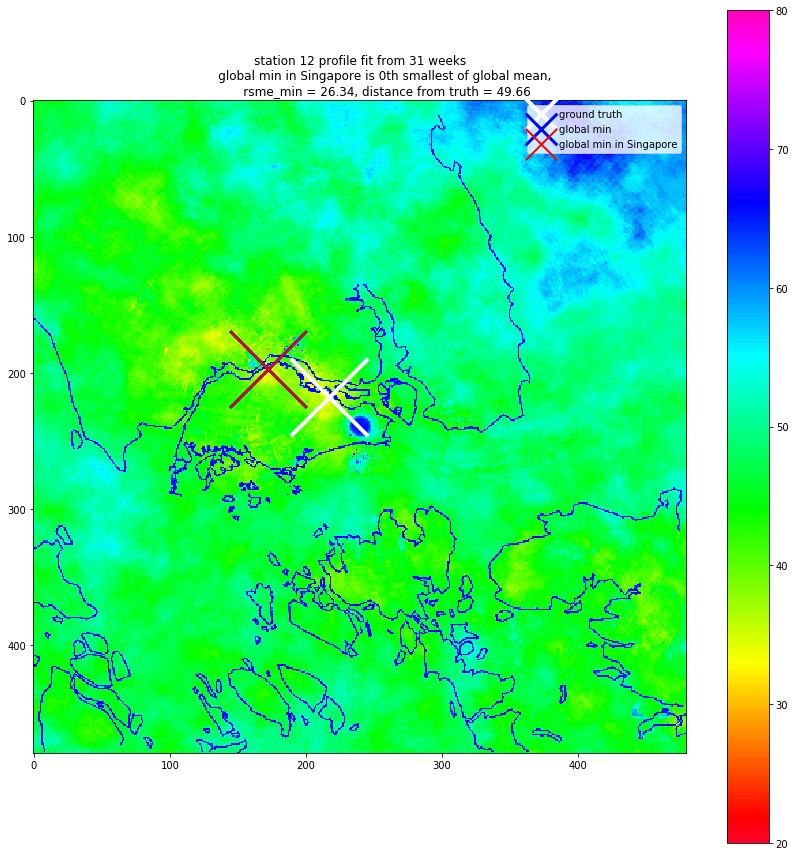

(12, 1000000, 94732, 26.343817226518684, False, 0)
124036
(196, 258)
124036
124036
(196, 258)
c


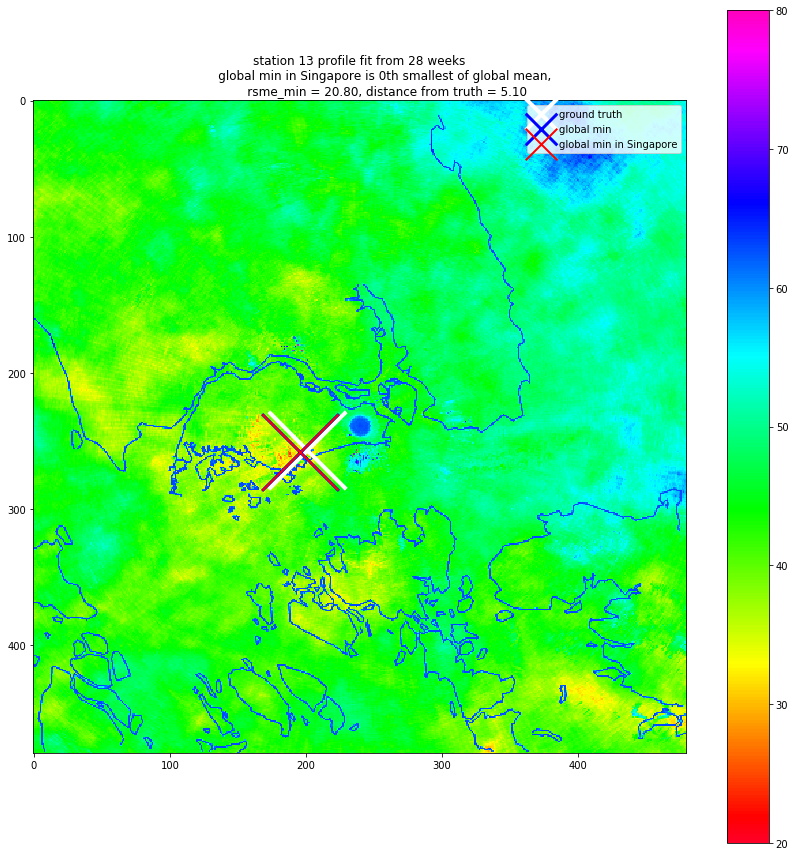

(13, 1000000, 124036, 20.795862180609912, True, 0)
114401
(161, 238)
114401
114401
(161, 238)
b


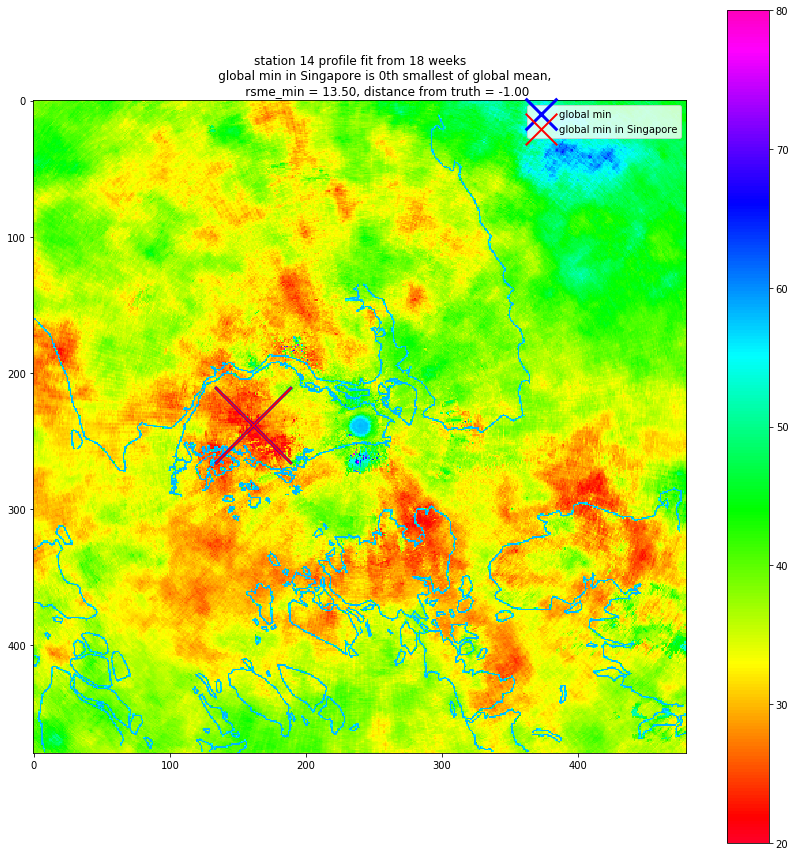

(14, 1000000, 114401, 13.495611463308052, True, 0)
119679
(159, 249)
119679
119679
(159, 249)
b


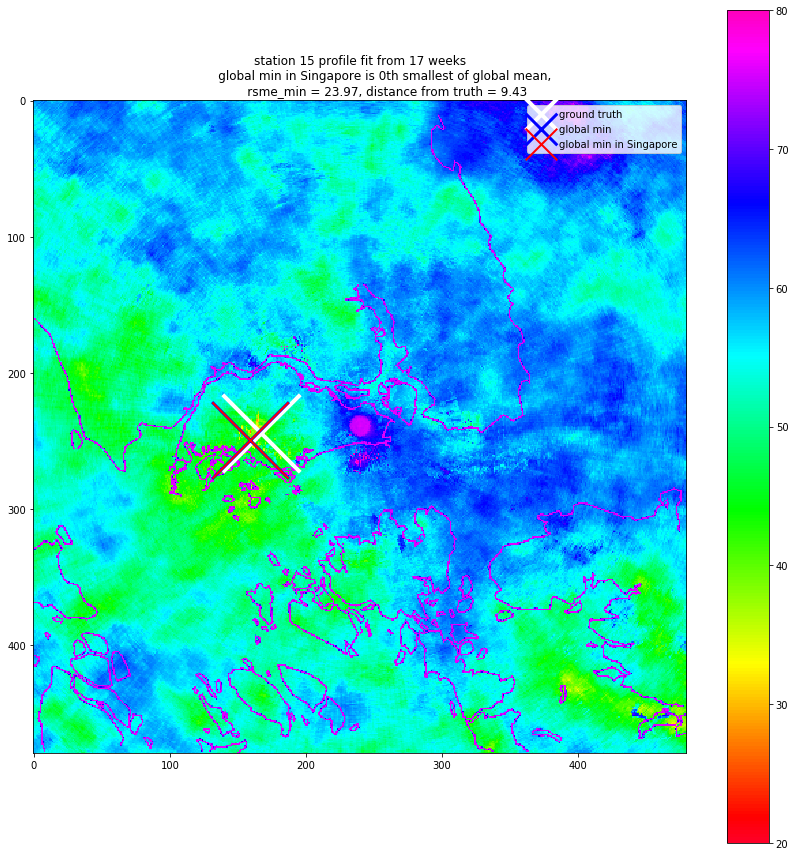

(15, 1000000, 119679, 23.9726931928839, True, 0)
128835
(195, 268)
128835
128835
(195, 268)
c


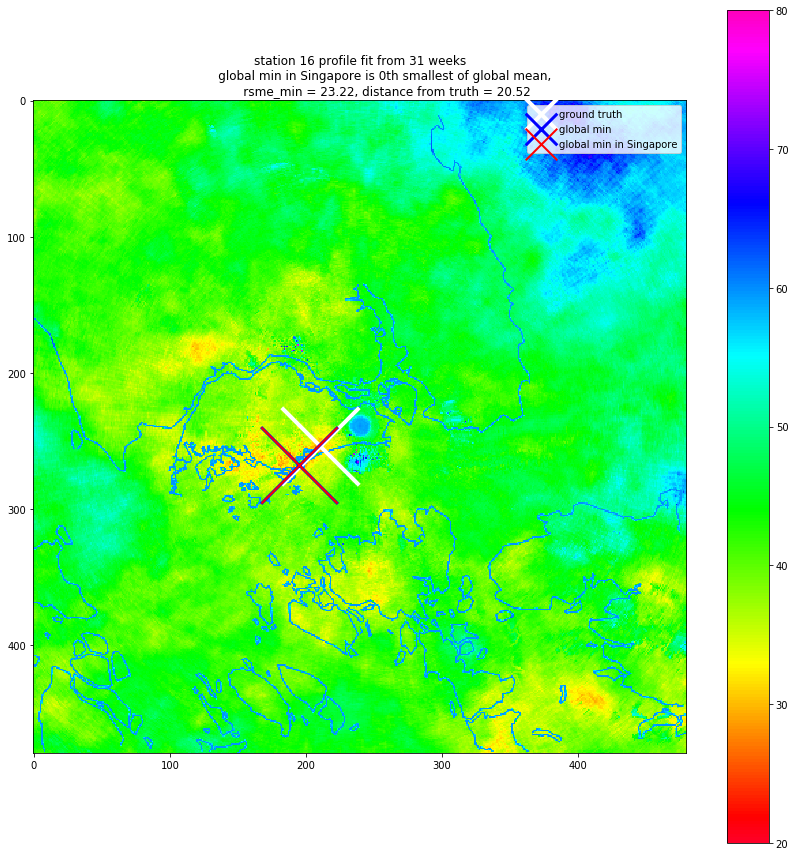

(16, 1000000, 128835, 23.22188933153434, False, 0)
95211
(171, 198)
95211
95211
(171, 198)
c


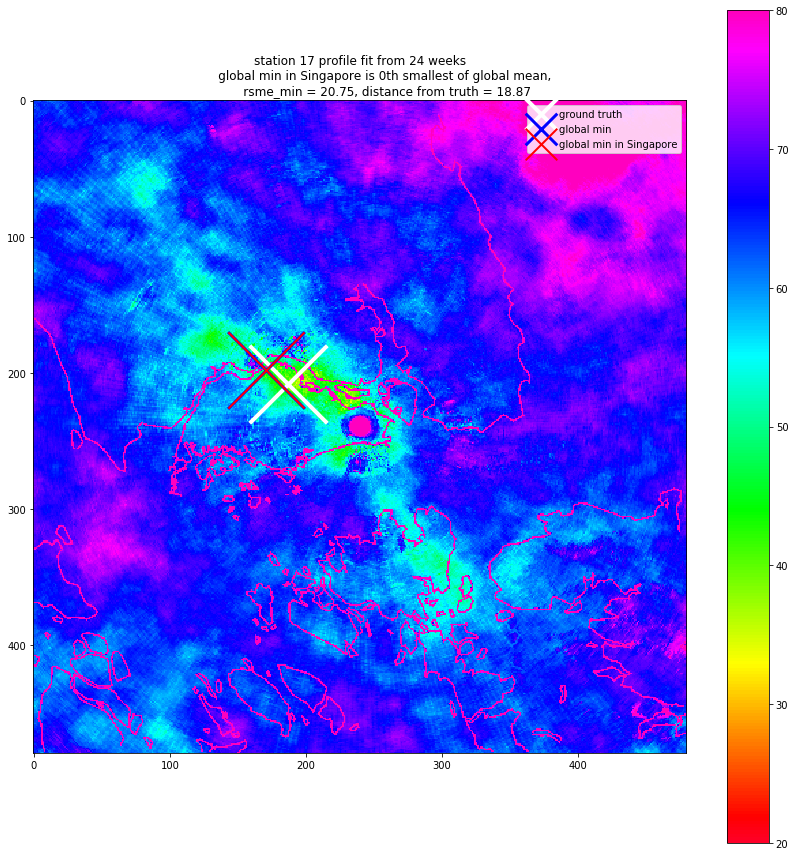

(17, 1000000, 95211, 20.754033434140688, True, 0)
122081
(161, 254)
122081
122081
(161, 254)
b


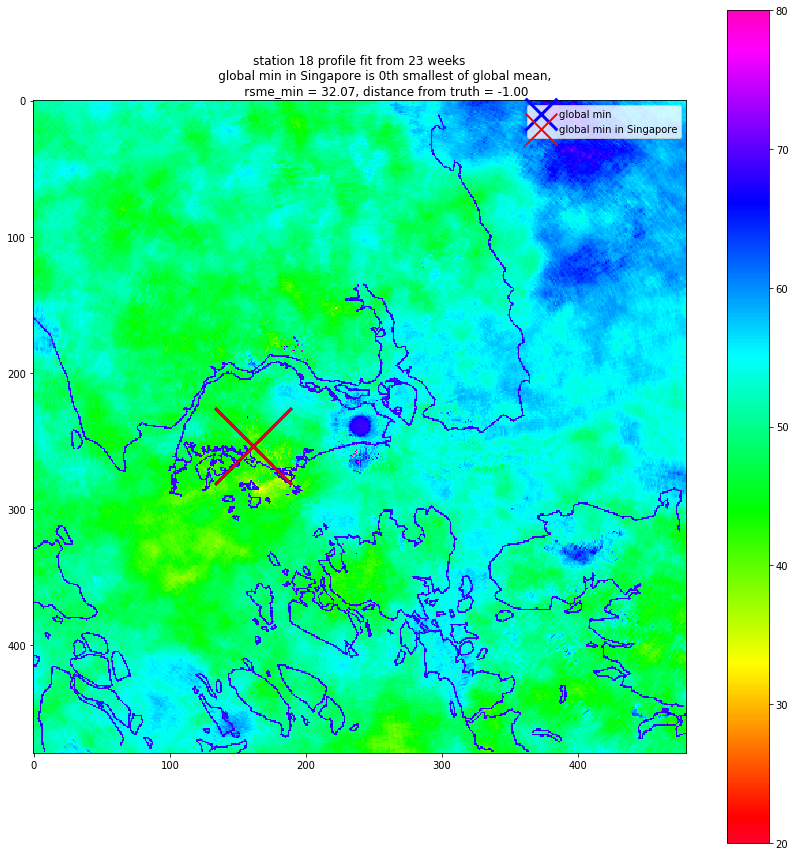

(18, 1000000, 122081, 32.06791720146837, True, 0)
111525
(165, 232)
111525
111525
(165, 232)
b


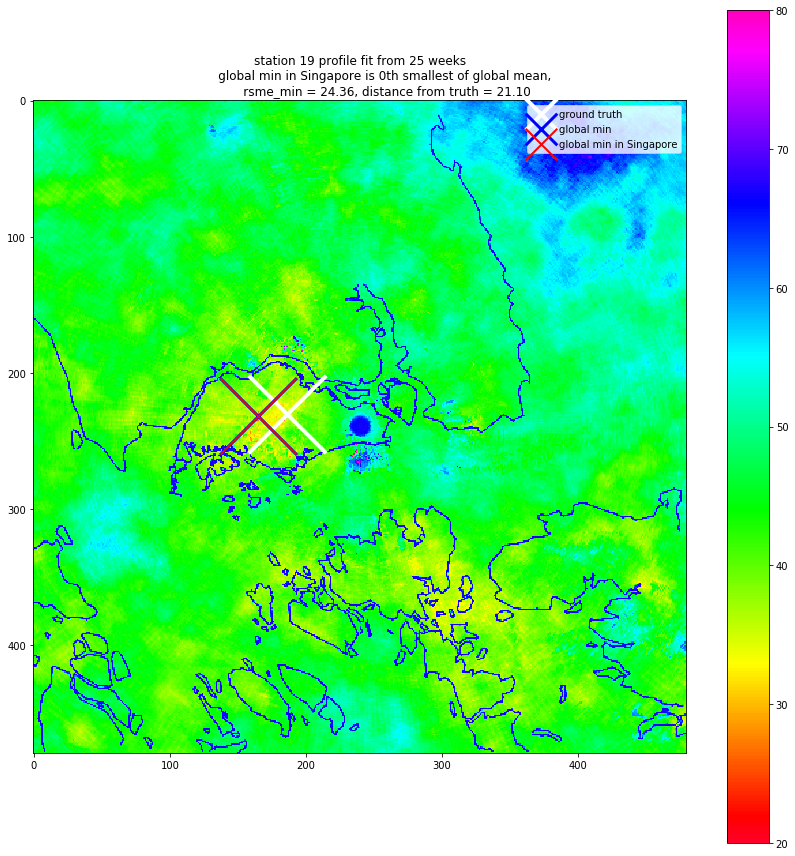

(19, 1000000, 111525, 24.358428632396247, True, 0)
112964
(164, 235)
112964
112964
(164, 235)
b


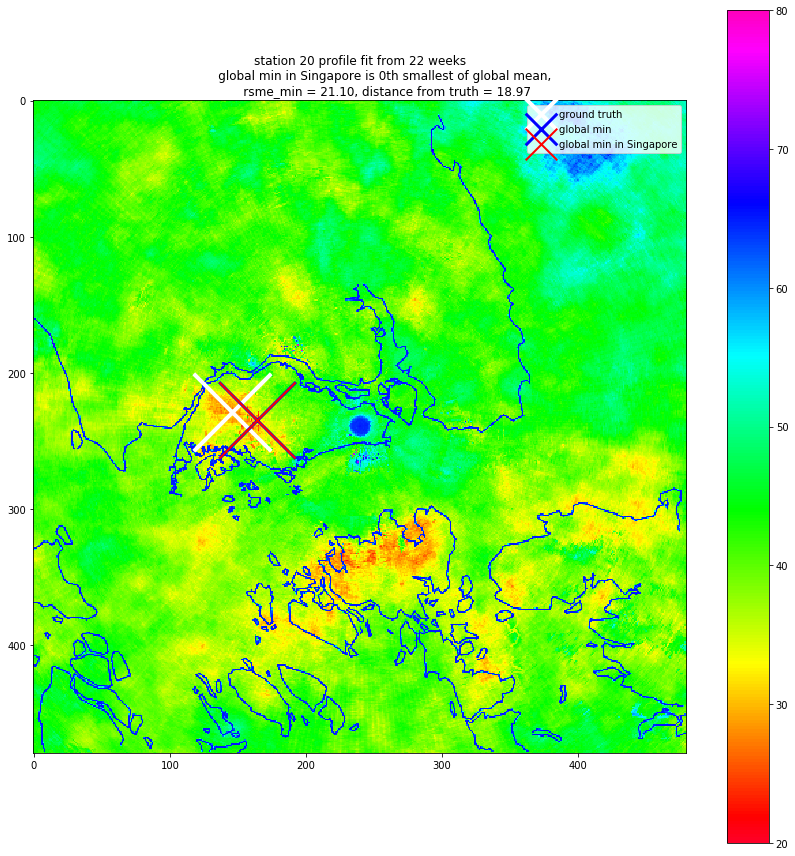

(20, 1000000, 112964, 21.10358486651516, True, 0)
110565
(165, 230)
110565
110565
(165, 230)
b


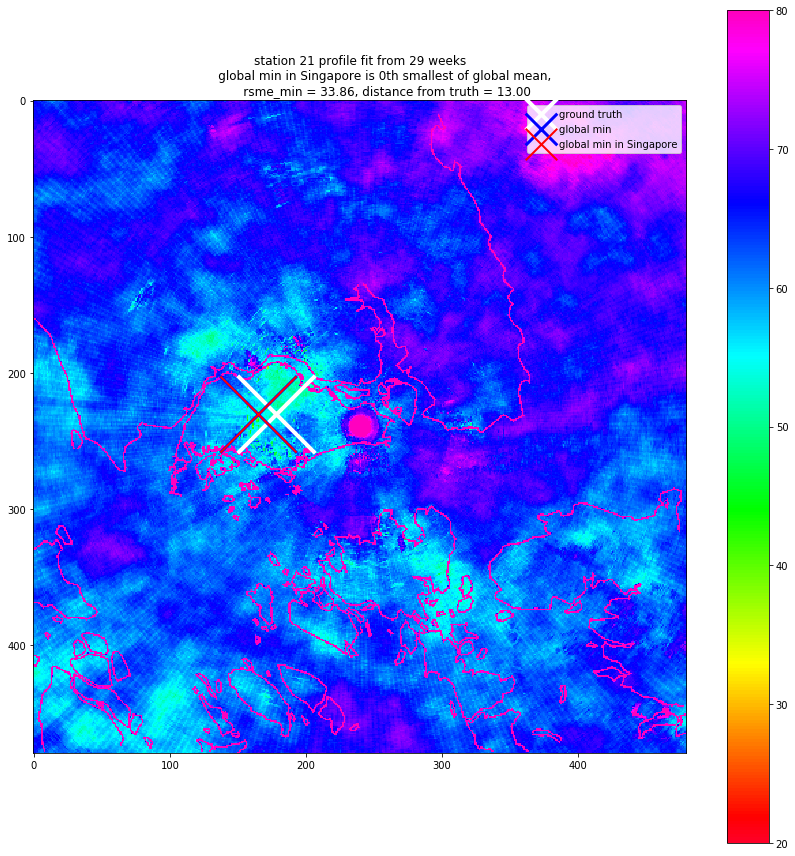

(21, 1000000, 110565, 33.86240286190968, True, 0)
94732
(172, 197)
94732
94732
(172, 197)
c


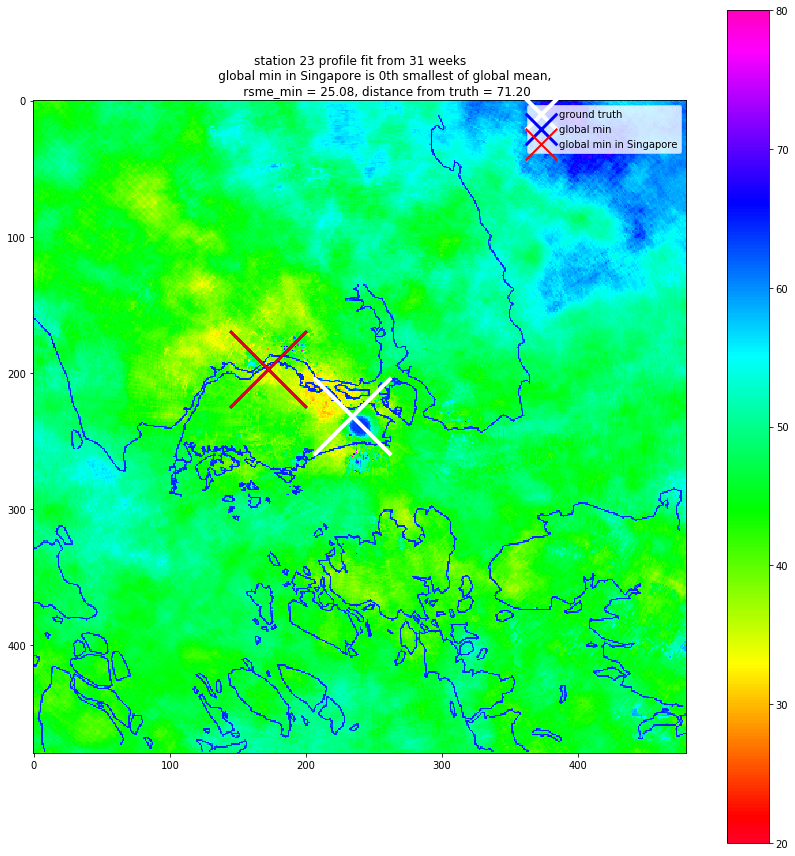

(23, 1000000, 94732, 25.079472150893565, False, 0)
111525
(165, 232)
111525
111525
(165, 232)
b


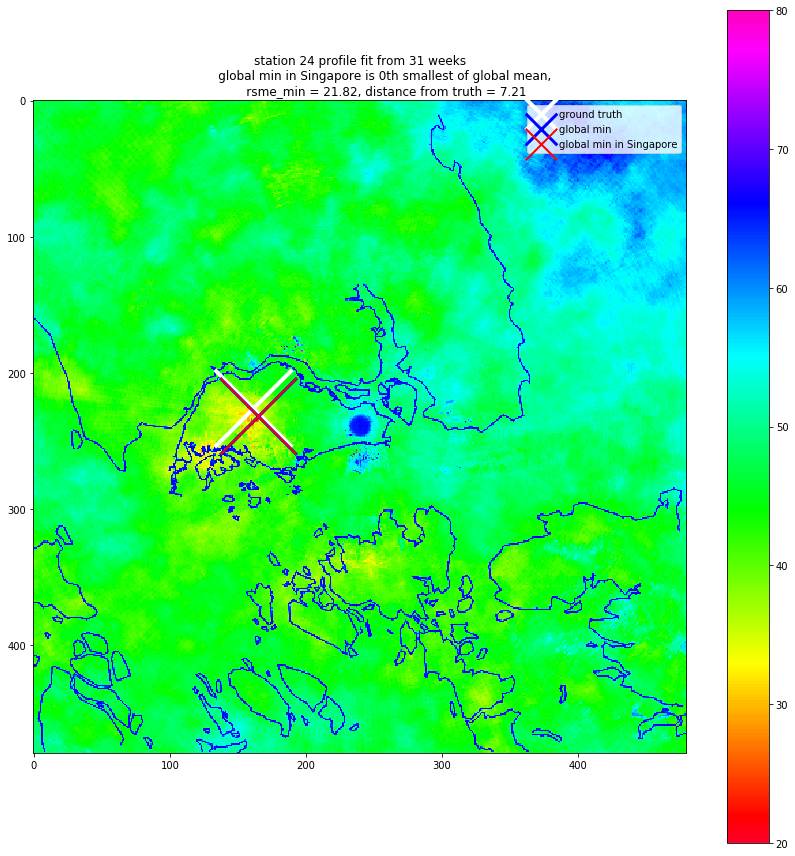

(24, 1000000, 111525, 21.817357592499494, False, 0)
121600
(160, 253)
121600
121600
(160, 253)
b


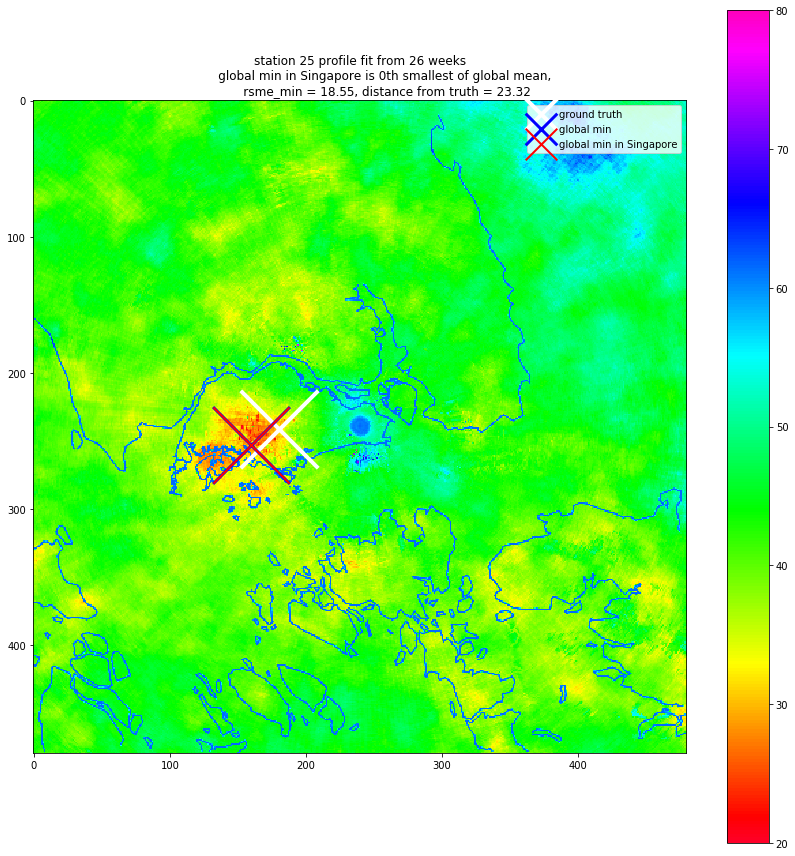

(25, 1000000, 121600, 18.55330394632467, True, 0)
110533
(133, 230)
110533
110533
(133, 230)
b


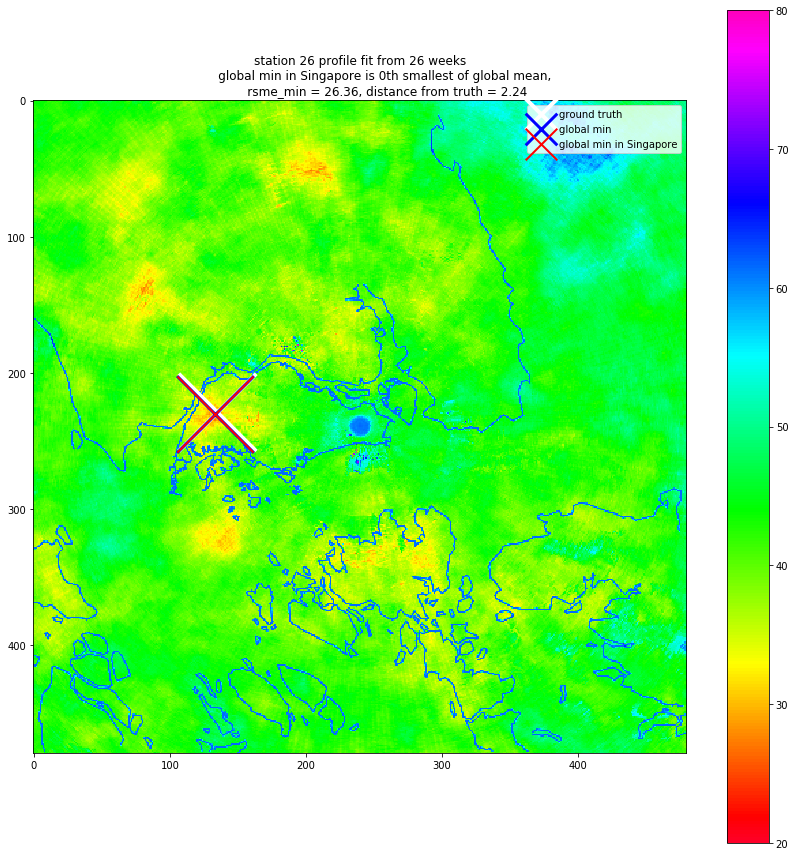

(26, 1000000, 110533, 26.36062555586911, True, 0)
116799
(159, 243)
116799
116799
(159, 243)
b


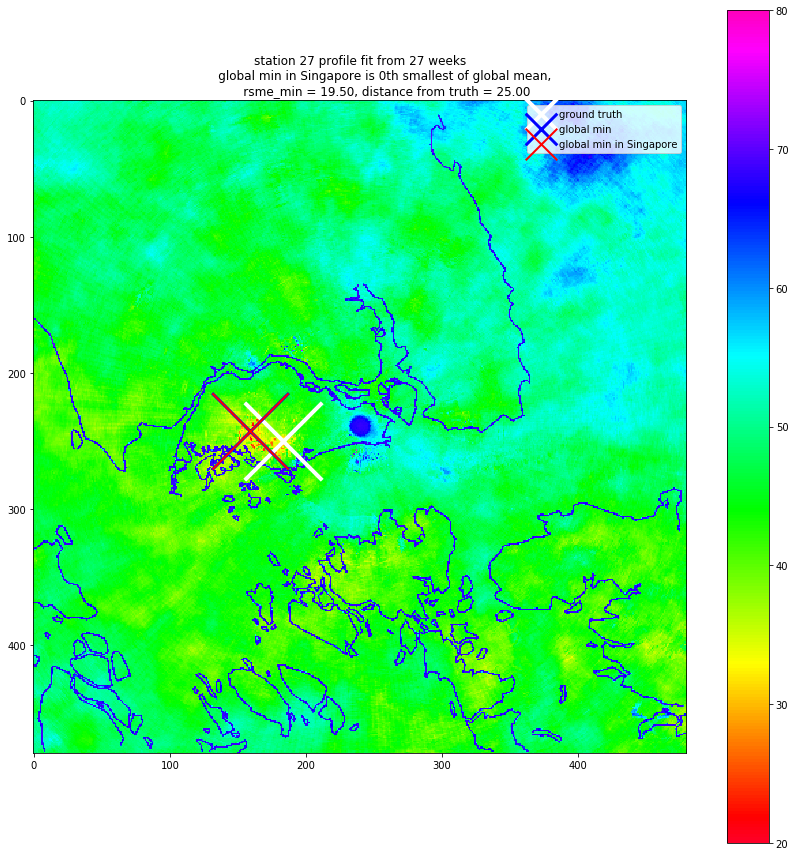

(27, 1000000, 116799, 19.502632569732278, True, 0)
121600
(160, 253)
121600
121600
(160, 253)
b


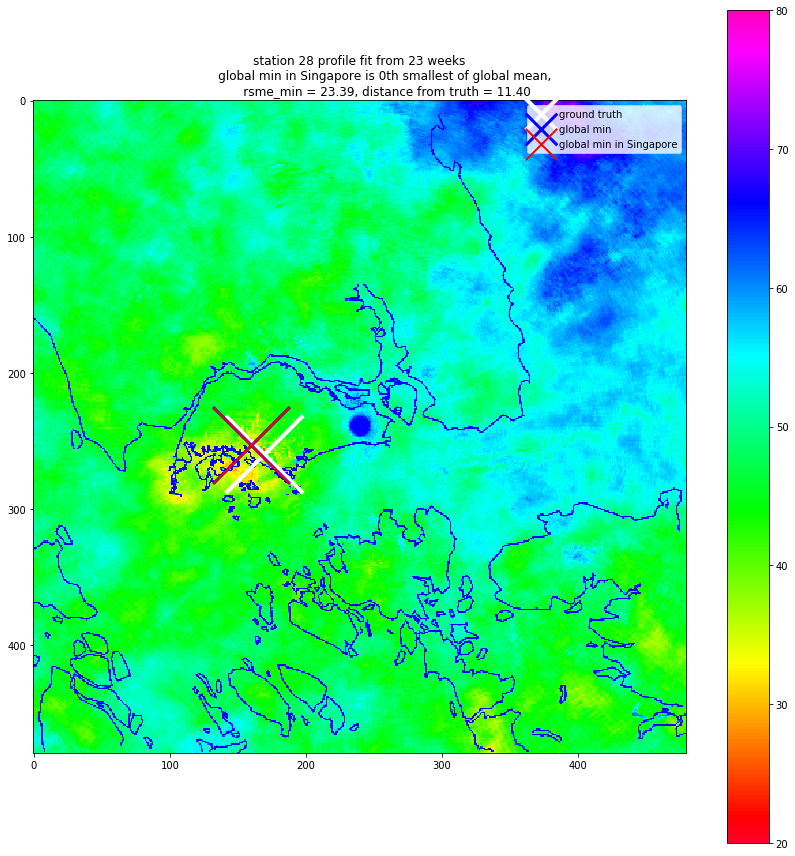

(28, 1000000, 121600, 23.39362111135523, True, 0)
162019
(259, 337)
162019
162019
(259, 337)
e
148110
(270, 308)
e
148109
(269, 308)
e
147635
(275, 307)
e
149075
(275, 310)
e
149063
(263, 310)
e
162961
(241, 339)
e
150032
(272, 312)
e
162962
(242, 339)
e
149557
(277, 311)
e
149553
(273, 311)
e
147634
(274, 307)
e
150995
(275, 314)
e
146677
(277, 305)
e
149073
(273, 310)
e
159127
(247, 331)
e
162498
(258, 338)
e
160580
(260, 334)
e
153388
(268, 319)
e
157697
(257, 328)
e
149076
(276, 310)
e
159126
(246, 331)
e
133290
(330, 277)
e
161535
(255, 336)
e
148106
(266, 308)
e
162500
(260, 338)
e
148115
(275, 308)
e
159124
(244, 331)
e
149074
(274, 310)
e
150982
(262, 314)
e
162979
(259, 339)
e
147632
(272, 307)
e
161536
(256, 336)
e
148583
(263, 309)
e
145237
(277, 302)
e
159125
(245, 331)
e
149071
(271, 310)
e
147633
(273, 307)
e
149552
(272, 311)
e
149554
(274, 311)
e
133777
(337, 278)
e
148590
(270, 309)
e
153874
(274, 320)
e
162499
(259, 338)
e
159140
(260, 331)
e
224679
(39, 468)
e
133773

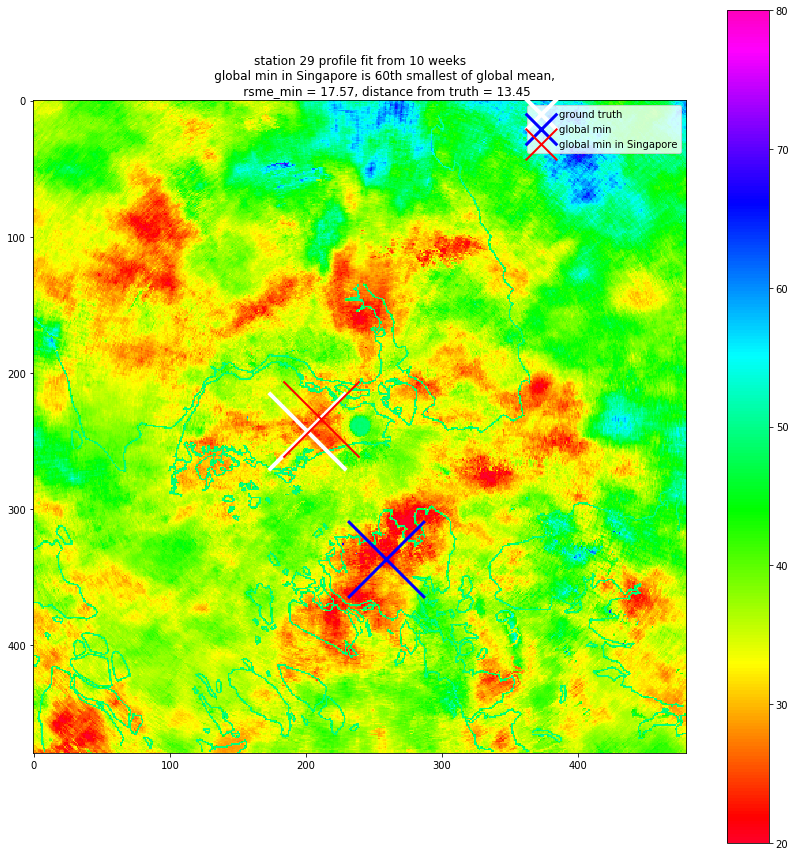

(29, 1000000, 112531, 17.571408358962202, True, 60)
120164
(164, 250)
120164
120164
(164, 250)
b


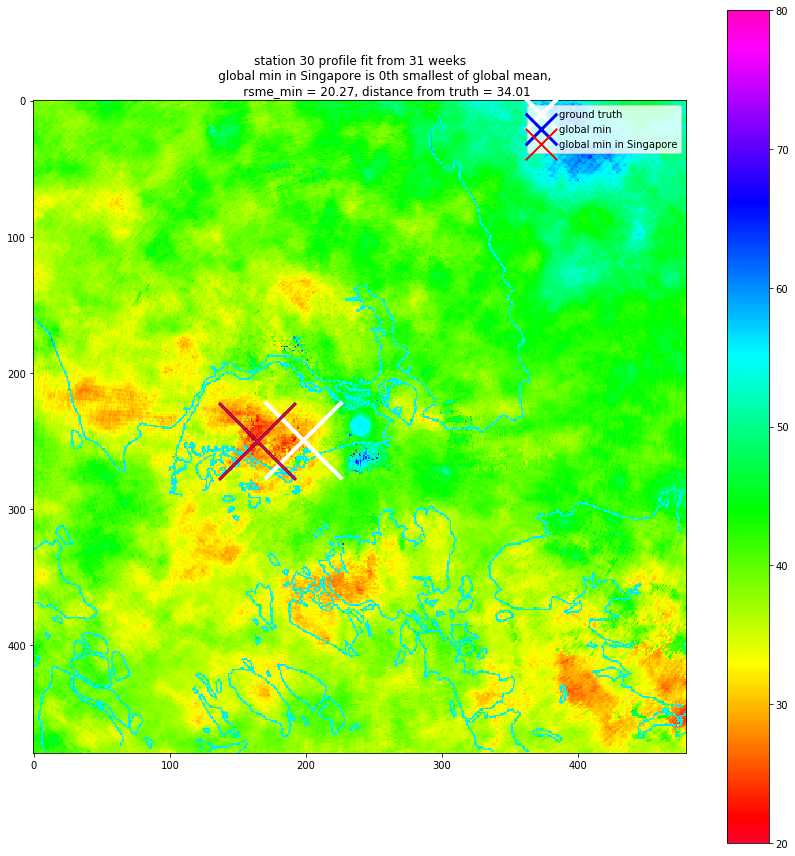

(30, 1000000, 120164, 20.265124237661453, False, 0)
115833
(153, 241)
115833
115833
(153, 241)
b


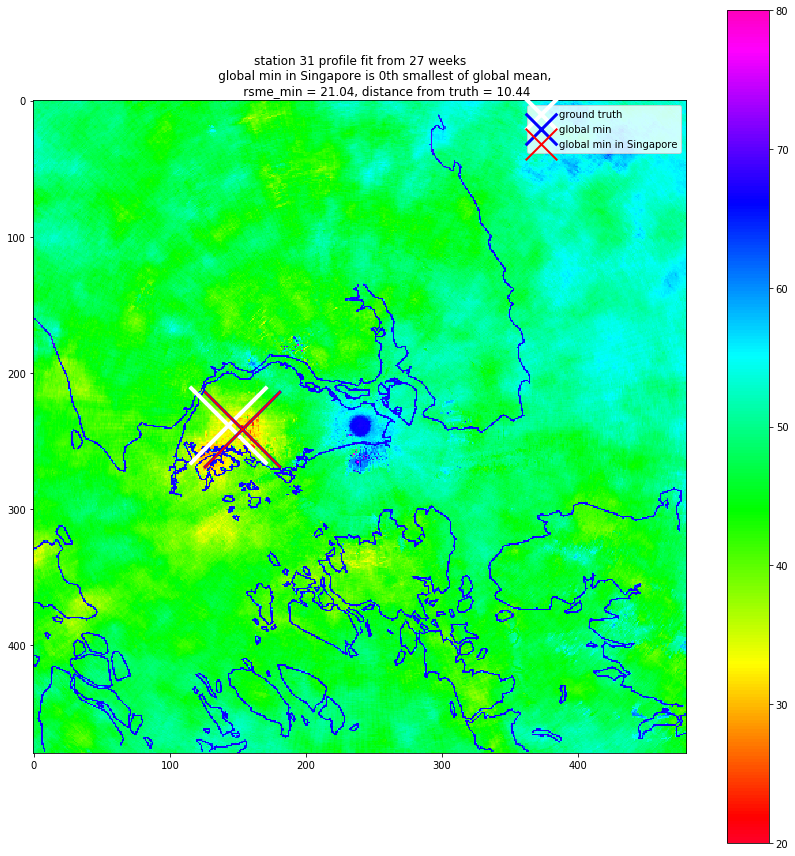

(31, 1000000, 115833, 21.03923906868464, True, 0)
119680
(160, 249)
119680
119680
(160, 249)
b


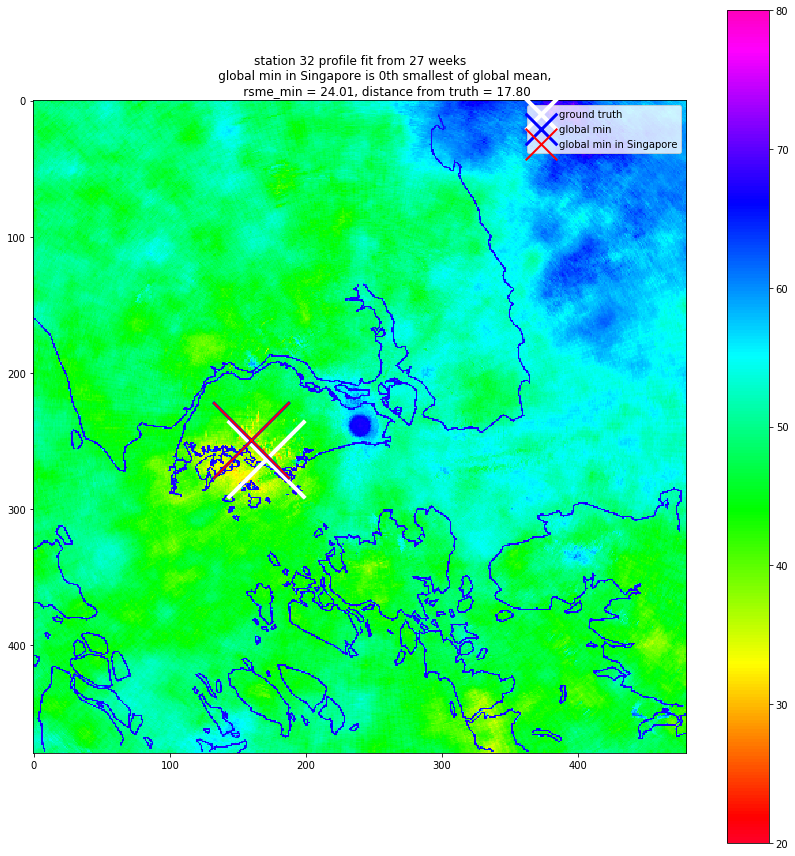

(32, 1000000, 119680, 24.009961071349203, True, 0)
122060
(140, 254)
122060
122060
(140, 254)
b


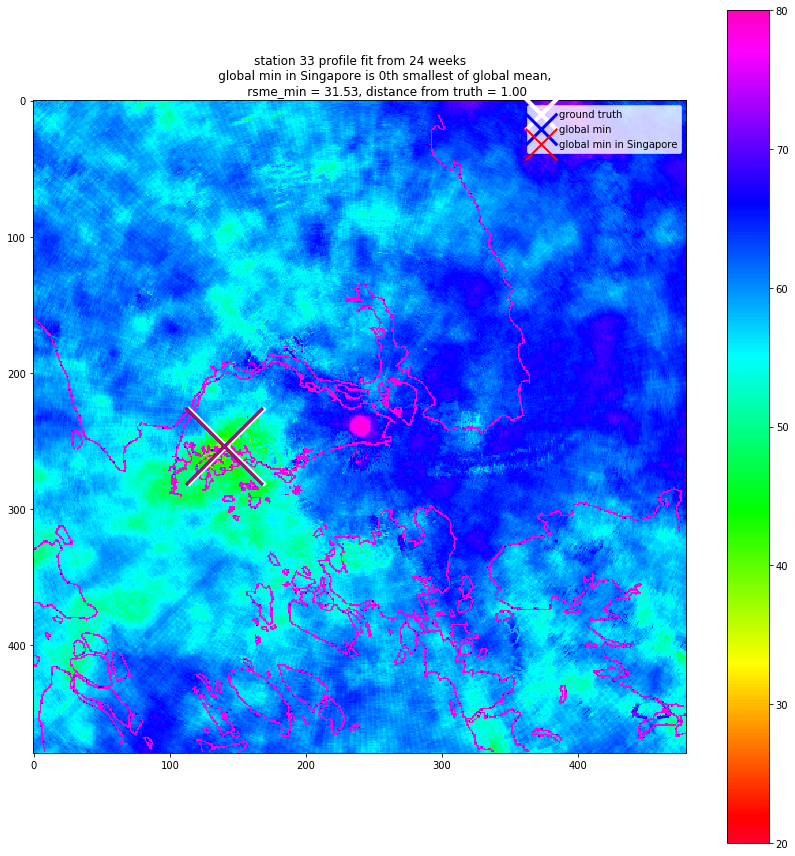

(33, 1000000, 122060, 31.53196180714915, True, 0)
88491
(171, 184)
88491
88491
(171, 184)
120160
(160, 250)
b


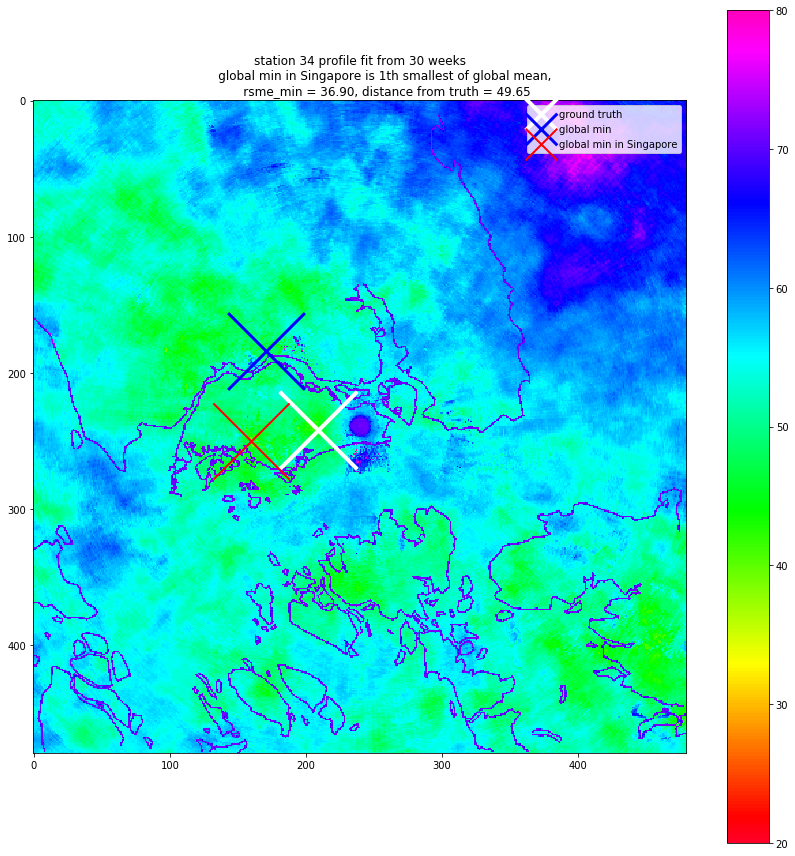

(34, 1000000, 120160, 36.901441228593185, True, 1)
94732
(172, 197)
94732
94732
(172, 197)
c


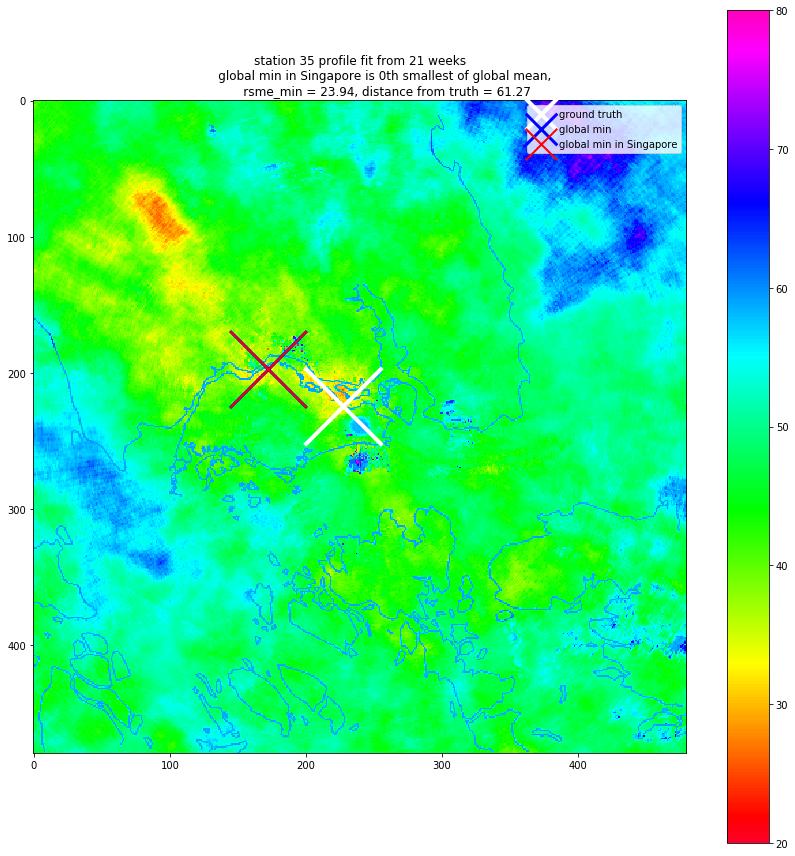

(35, 1000000, 94732, 23.936591674109412, True, 0)
124036
(196, 258)
124036
124036
(196, 258)
c


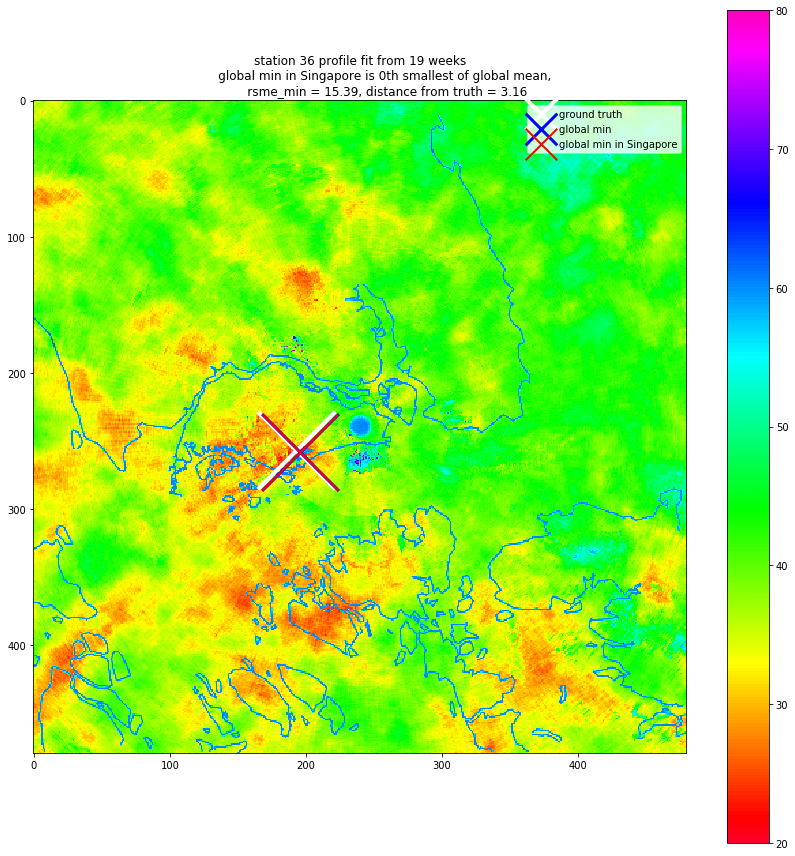

(36, 1000000, 124036, 15.391531923071435, True, 0)
125405
(125, 261)
125405
125405
(125, 261)
b


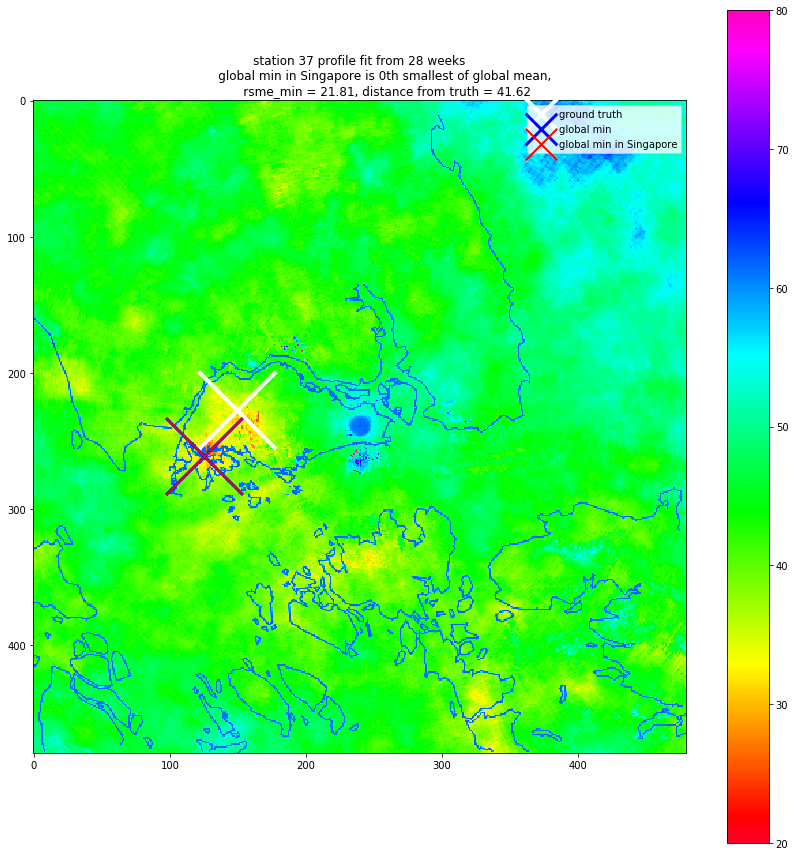

(37, 1000000, 125405, 21.81274136978743, True, 0)
88012
(172, 183)
88012
88012
(172, 183)
87999
(159, 183)
88491
(171, 184)
87514
(154, 182)
87034
(154, 181)
84647
(167, 176)
99045
(165, 206)
b


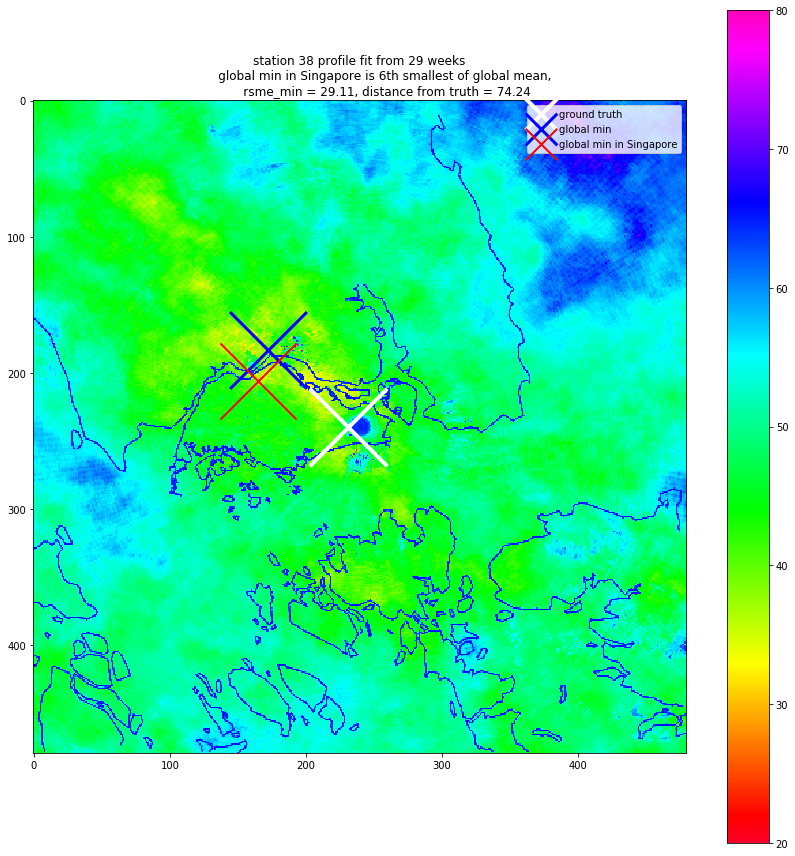

(38, 1000000, 99045, 29.11315636016914, True, 6)
110565
(165, 230)
110565
110565
(165, 230)
b


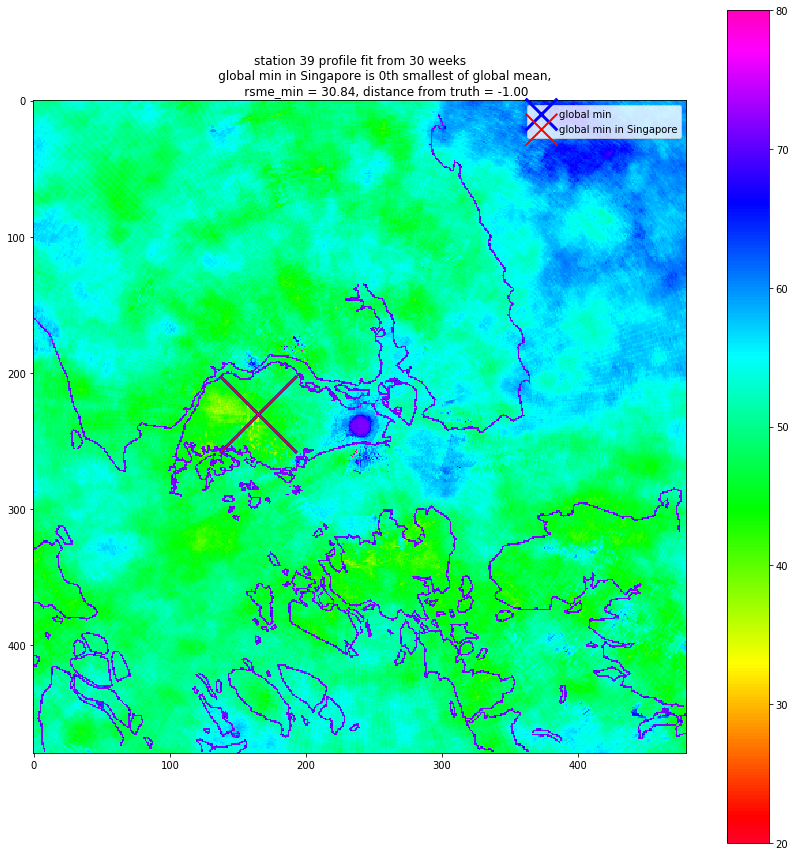

(39, 1000000, 110565, 30.836406725806278, True, 0)
125948
(188, 262)
125948
125948
(188, 262)
c


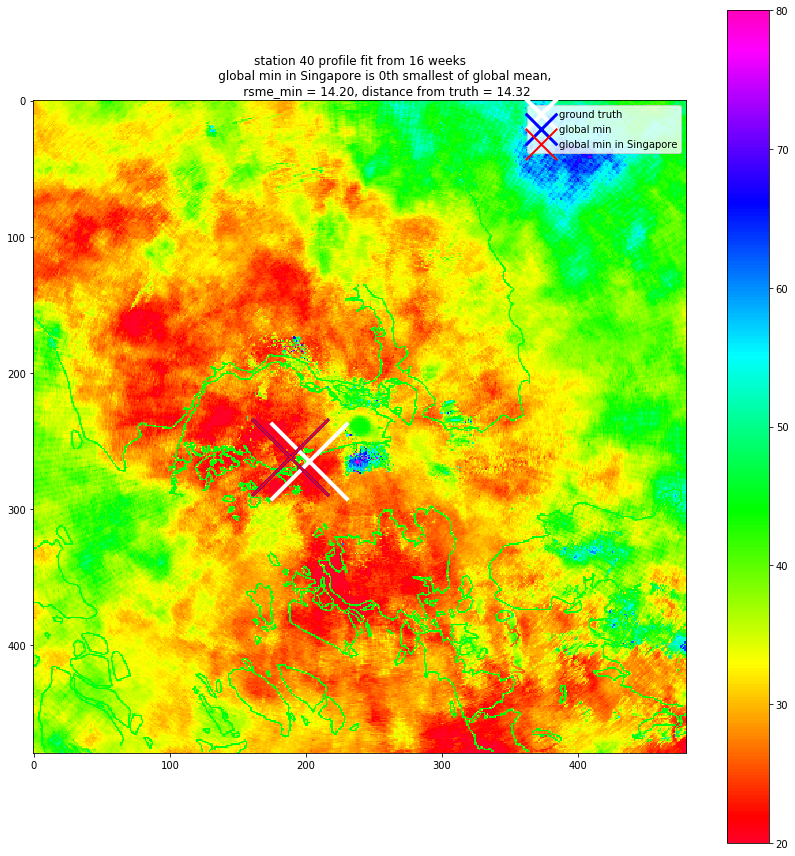

(40, 1000000, 125948, 14.195937843626606, True, 0)
119199
(159, 248)
119199
119199
(159, 248)
b


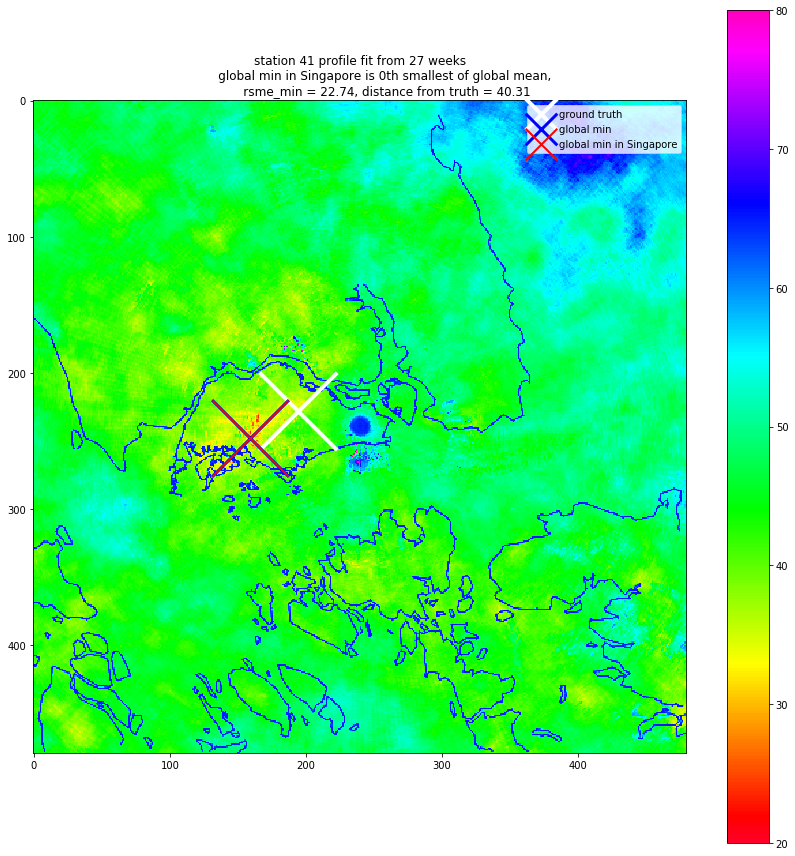

(41, 1000000, 119199, 22.736953610208936, True, 0)
94225
(145, 196)
94225
94225
(145, 196)
153858
(258, 320)
e
100912
(112, 210)
93745
(145, 195)
94704
(144, 197)
b


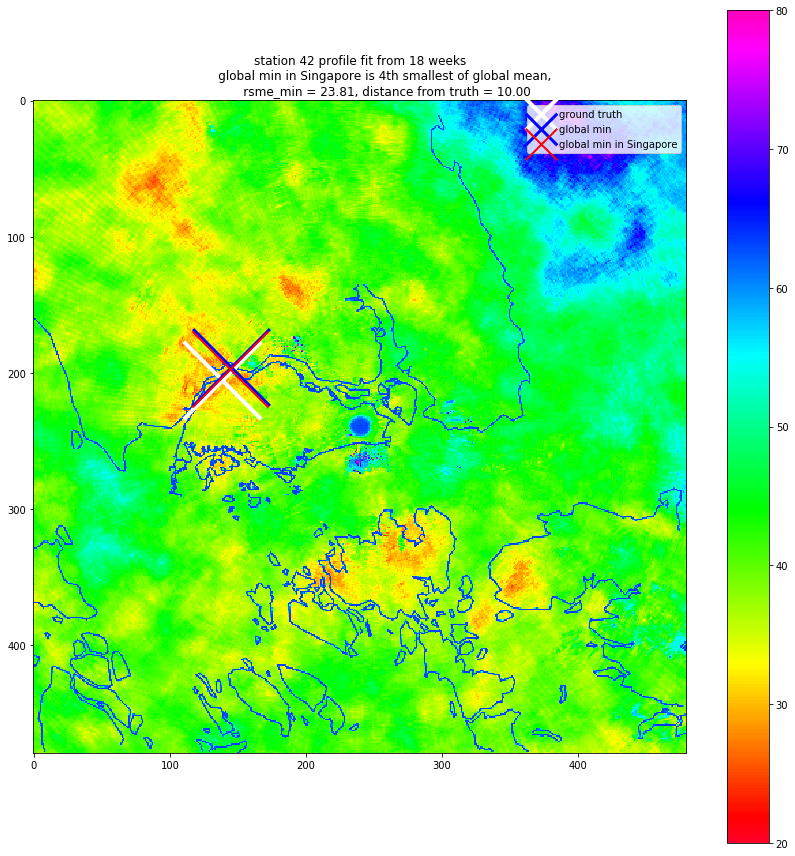

(42, 1000000, 94704, 23.810364554839445, True, 4)
88511
(191, 184)
88511
88511
(191, 184)
94732
(172, 197)
c


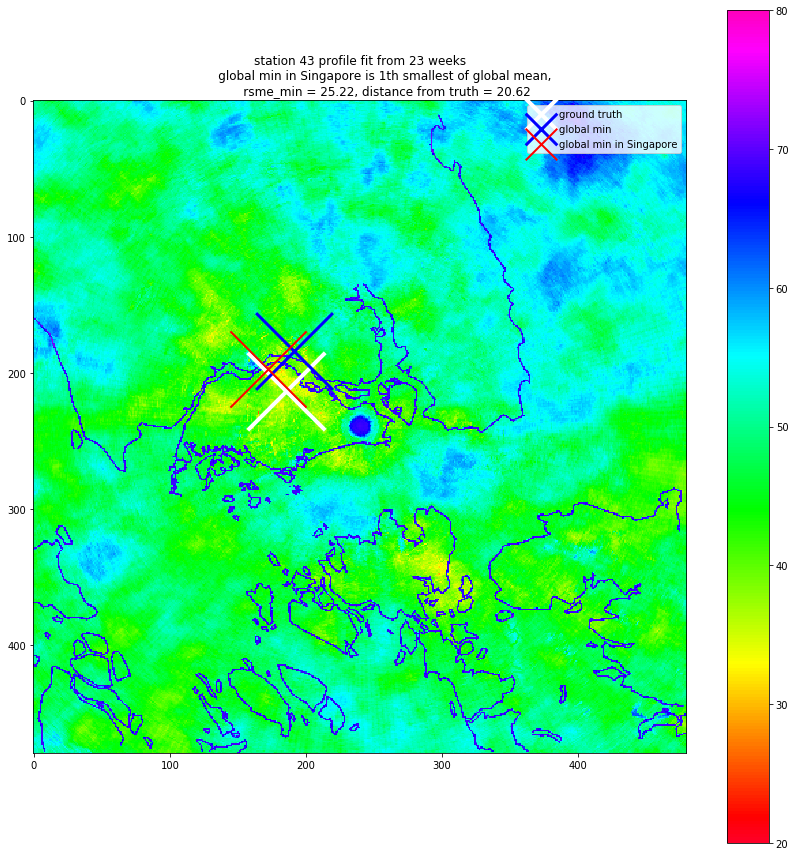

(43, 1000000, 94732, 25.220039684618428, True, 1)
95211
(171, 198)
95211
95211
(171, 198)
c


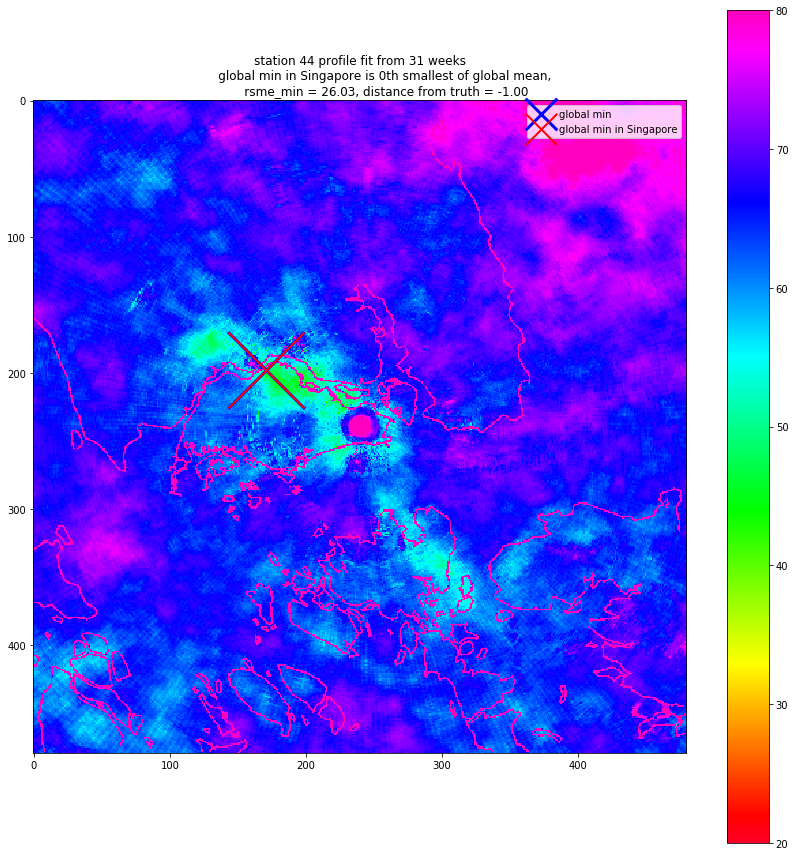

(44, 1000000, 95211, 26.02983491613978, False, 0)
126395
(155, 263)
126395
126395
(155, 263)
b


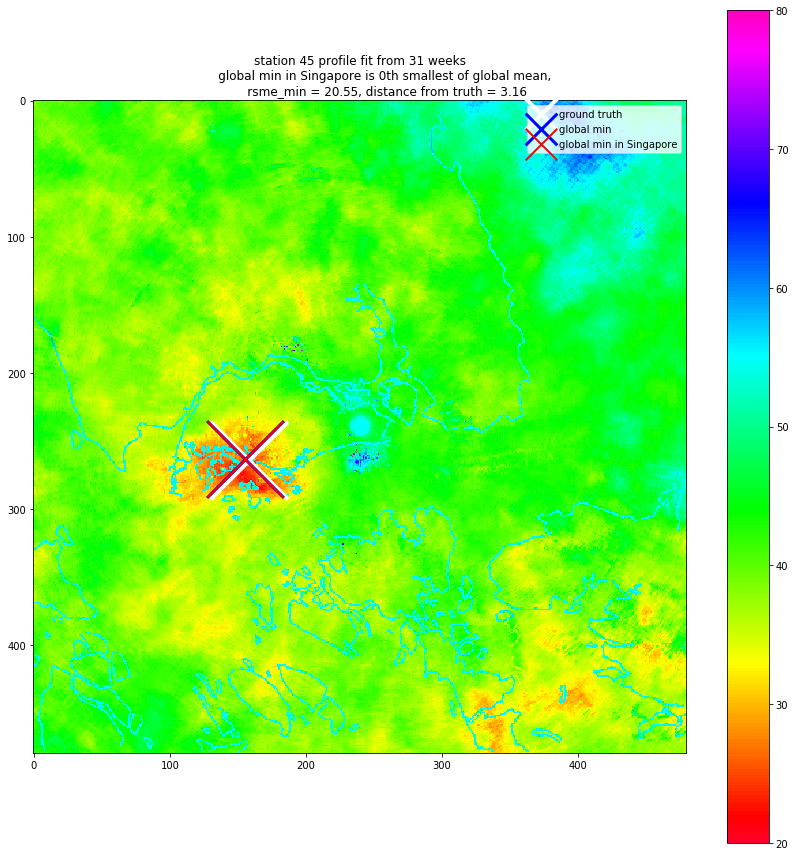

(45, 1000000, 126395, 20.550143188988198, False, 0)
123006
(126, 256)
123006
123006
(126, 256)
b


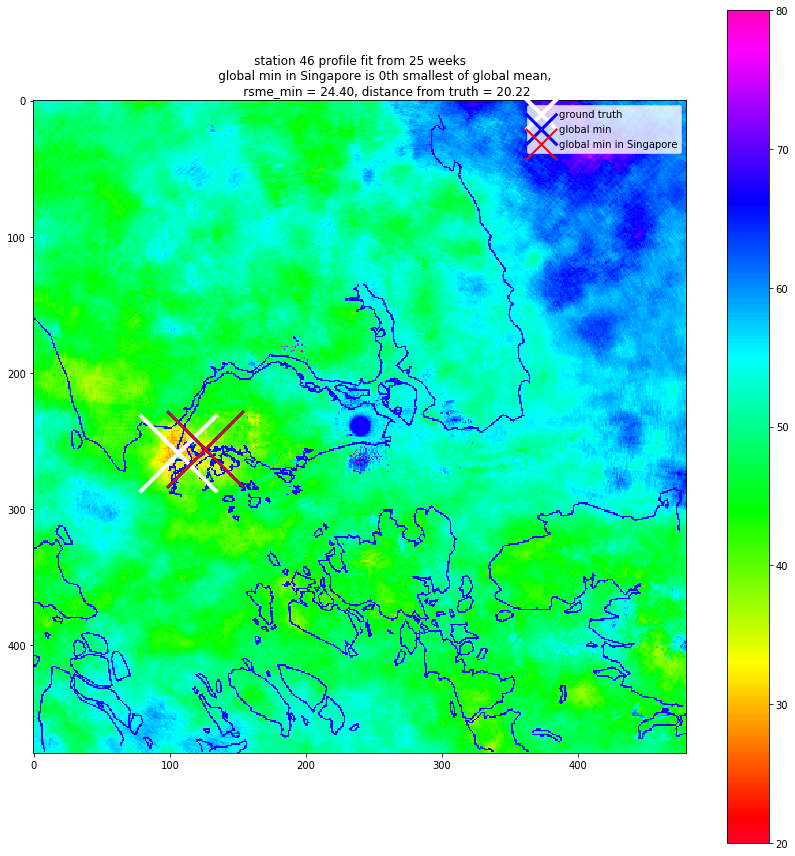

(46, 1000000, 123006, 24.40447500513465, True, 0)
119697
(177, 249)
119697
119697
(177, 249)
c


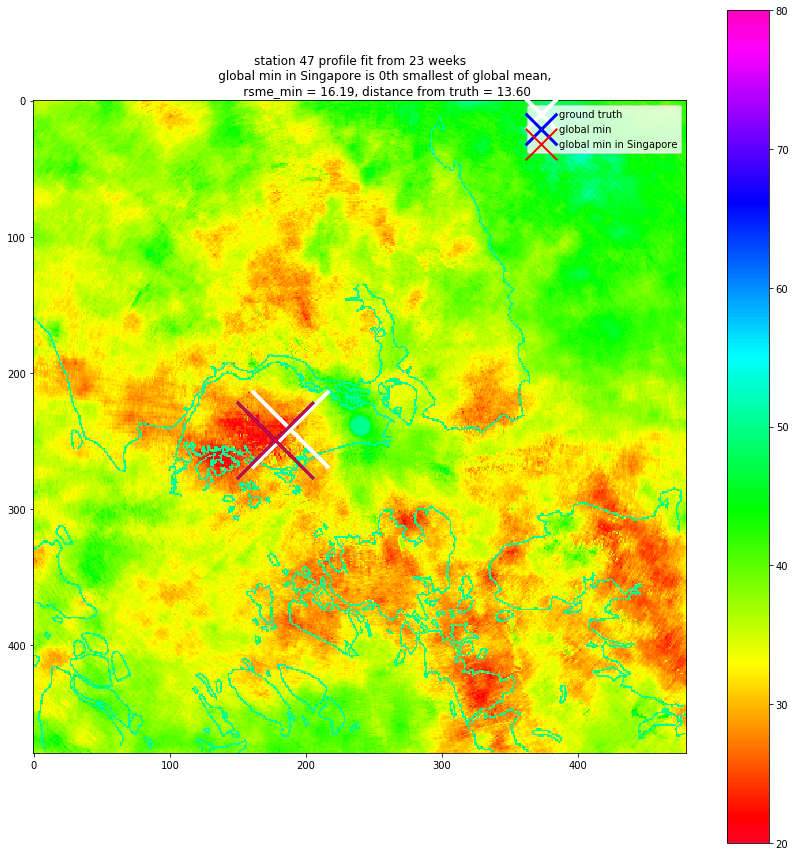

(47, 1000000, 119697, 16.191692514241833, True, 0)
101999
(239, 212)
101999
101999
(239, 212)
d


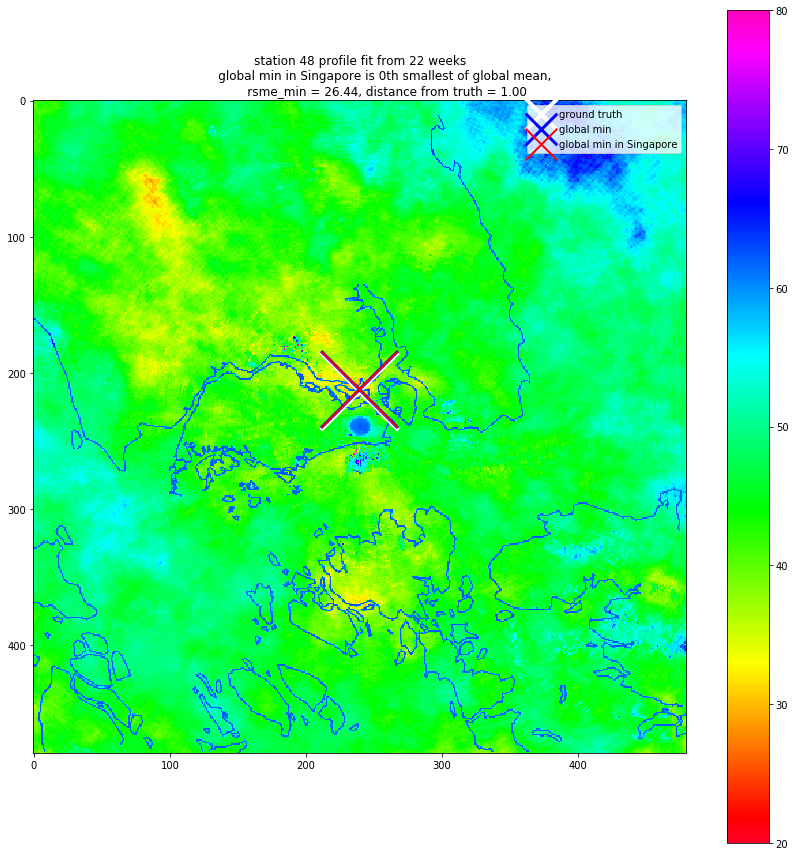

(48, 1000000, 101999, 26.443163436167524, True, 0)
146075
(155, 304)
146075
146075
(155, 304)
b


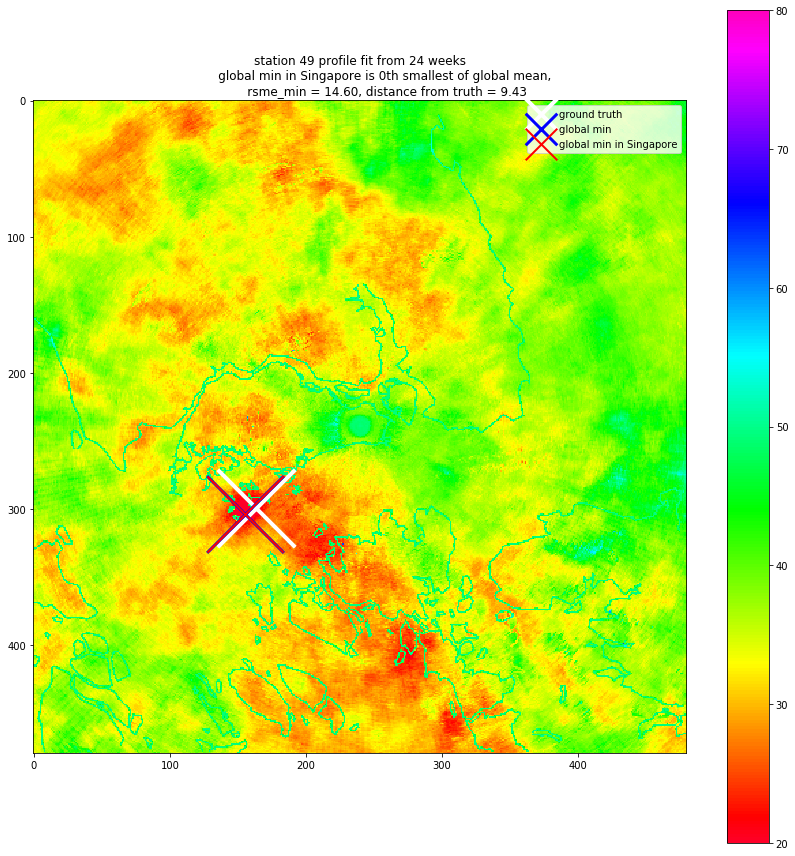

(49, 1000000, 146075, 14.603399236575047, True, 0)
station,x,y,least_rsme,dist_from_ground_truth
[0, 165, 205, 2]
[1, 123, 257, 0]
[2, 219, 256, 0]
[3, 225, 217, 0]
[4, 160, 249, 2]
[5, 159, 249, 0]
[6, 221, 208, 0]
[7, 171, 198, 0]
[8, 123, 257, 0]
[9, 181, 263, 0]
[10, 133, 276, 0]
[11, 159, 243, 0]
[12, 172, 197, 0]
[13, 196, 258, 0]
[14, 161, 238, 0]
[15, 159, 249, 0]
[16, 195, 268, 0]
[17, 171, 198, 0]
[18, 161, 254, 0]
[19, 165, 232, 0]
[20, 164, 235, 0]
[21, 165, 230, 0]
[23, 172, 197, 0]
[24, 165, 232, 0]
[25, 160, 253, 0]
[26, 133, 230, 0]
[27, 159, 243, 0]
[28, 160, 253, 0]
[29, 211, 234, 60]
[30, 164, 250, 0]
[31, 153, 241, 0]
[32, 160, 249, 0]
[33, 140, 254, 0]
[34, 160, 250, 1]
[35, 172, 197, 0]
[36, 196, 258, 0]
[37, 125, 261, 0]
[38, 165, 206, 6]
[39, 165, 230, 0]
[40, 188, 262, 0]
[41, 159, 248, 0]
[42, 144, 197, 4]
[43, 172, 197, 1]
[44, 171, 198, 0]
[45, 155, 263, 0]
[46, 126, 256, 0]
[47, 177, 249, 0]
[48, 239, 212, 0]
[49, 155, 304, 0]


In [34]:
import matplotlib.cm as cm

locations = []

for station in range(50):
    if station == 22:
        continue
    actual = np.array(gauge_df.loc[weeksint, str(station)])
    how_many_nan = np.count_nonzero(~np.isnan(actual))
    rmse = 1000000
    best = None
    
    plt.figure(figsize=(12,12))
    try:
        plt.scatter(stations_dict[station][0], stations_dict[station][1], s=6000,  linewidth='4',
                 marker='x', color="white", label="ground truth")
    except:
        pass
    temp = []
    a = np.add(radars.as_matrix(),-1*np.array(actual))
    b = np.sqrt(np.nanmean(np.power(a,2),axis=1))
    argmin_ = np.argmin(b)
    print(argmin_)
    x_crds, y_crds = argmin_%480, argmin_//480
    plt.scatter(x_crds, y_crds, s=5900, marker='x', color="blue", label="global min",  linewidth='3')
    min_rmse = np.min(b)
    pos = 0
    
    print(x_crds, y_crds)
    x_crds___i, y_crds___i = x_crds, y_crds
    
    argmins_ = np.argpartition(b, range(500))
    print(argmins_)[0]
    for i in range(500):
        pos = i
        argmin_ = argmins_[i]
        min_rmse = b[argmin_]
        print(argmin_)
        x_crds___i, y_crds___i = argmin_%480, argmin_//480
        x_crds, y_crds = x_crds___i, y_crds___i
        print(x_crds___i, y_crds___i)
        if x_crds___i < 85 or x_crds___i > 299 or y_crds___i > 380 - (x_crds___i-85)*(380-270)/(299-85):
            print("e")
        elif x_crds___i < 119:
            if y_crds___i > 256 + (x_crds___i-85)*(205-256)/(119-85):
                print("a")
                break
        elif x_crds___i < 171:
            if y_crds___i > 205 + (x_crds___i-119)*(188-205)/(171-119):
                print("b")
                break
        elif x_crds___i < 226:
            if y_crds___i > 188 + (x_crds___i-171)*(205-188)/(226-171):
                print("c")
                break
        elif x_crds___i < 300:
            if y_crds___i > 205:
                print("d")
                break
        else:
            print("z")
            
        
#     print(radars.index()[argmin_])

#     for index, row in radars.iterrows():
#     #     if index[1] == 0 and index[0] % 50 == 0:
#     #         print(index)
#         pred = np.array(row[weeks])
        
#         temp_rmse = np.sqrt(np.nanmean(np.power((pred-actual),2)))
#         temp.append(temp_rmse)
#         if temp_rmse < rmse:
#             rmse = temp_rmse
#     #         print(rmse)
#             best = index
    try:
        distance_e = np.sqrt((x_crds___i-stations_dict[station][0])**2+(y_crds___i-stations_dict[station][1])**2)
        distance_e_ = distance_e
    except:
        distance_e = None
        distance_e_ = -1
    plt.title('''station {} profile fit from {} weeks
              global min in Singapore is {}th smallest of global mean, 
              rsme_min = {:.2f}, distance from truth = {:.2f}'''.format(station, how_many_nan, pos, min_rmse, distance_e_))
    plt.imshow([b[480*i:480*(i+1)] for i in range(480)],cmap=cm.gist_rainbow
               ,vmin=20, vmax=80
              )
    plt.colorbar()
    plt.scatter(x_crds, y_crds, s=5800, marker='x', color="red", label="global min in Singapore",  linewidth='2')
    lgnd = plt.legend(loc="upper right")
    for handle in lgnd.legendHandles:
        handle.set_sizes([1000])
    plt.tight_layout()
    plt.savefig("img/station{:02d}".format(station))
    plt.show()
    locations.append([station, x_crds, y_crds, pos])
    print(station, x_crds, y_crds, min_rmse, distance_e, pos, np.isnan(actual).any())

print("station,x,y,least_rsme,dist_from_ground_truth,nth smallest")    
for location in locations:
    print(location)

In [26]:
# plt.plot(station0, label='actual')
# plt.plot(radars.loc[249, 217], label='pred')
# plt.legend(['actual', 'pred'])

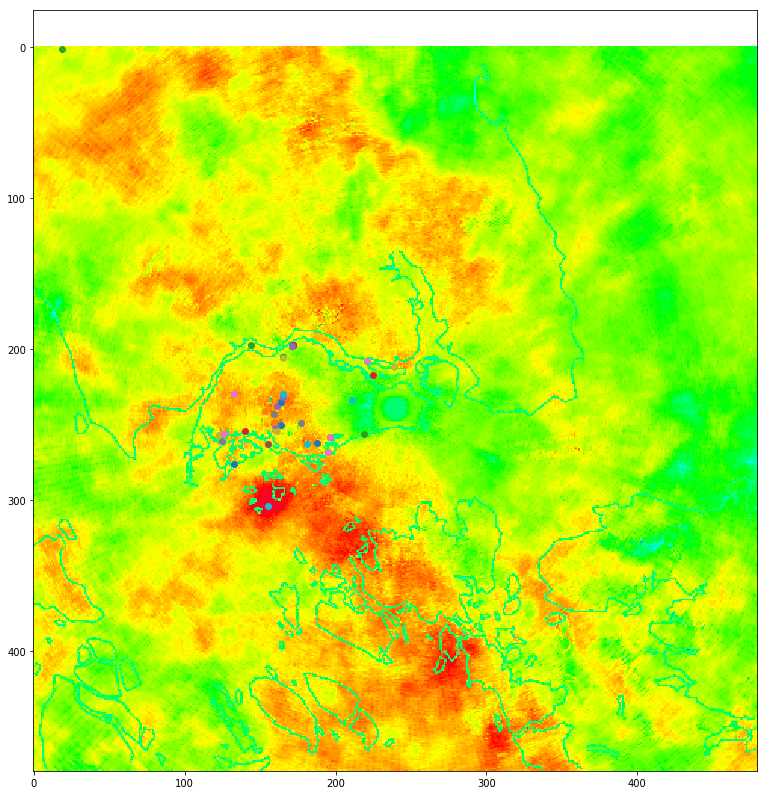

In [14]:
locations = [[0, 165, 205, 2],
[1, 123, 257, 0],
[2, 219, 256, 0],
[3, 225, 217, 0],
[4, 160, 249, 2],
[5, 159, 249, 0],
[6, 221, 208, 0],
[7, 171, 198, 0],
[8, 123, 257, 0],
[9, 181, 263, 0],
[10, 133, 276, 0],
[11, 159, 243, 0],
[12, 172, 197, 0],
[13, 196, 258, 0],
[14, 161, 238, 0],
[15, 159, 249, 0],
[16, 195, 268, 0],
[17, 171, 198, 0],
[18, 161, 254, 0],
[19, 165, 232, 0],
[20, 164, 235, 0],
[21, 165, 230, 0],
[22, 19, 1, 499],
[23, 172, 197, 0],
[24, 165, 232, 0],
[25, 160, 253, 0],
[26, 133, 230, 0],
[27, 159, 243, 0],
[28, 160, 253, 0],
[29, 211, 234, 60],
[30, 164, 250, 0],
[31, 153, 241, 0],
[32, 160, 249, 0],
[33, 140, 254, 0],
[34, 160, 250, 1],
[35, 172, 197, 0],
[36, 196, 258, 0],
[37, 125, 261, 0],
[38, 165, 206, 6],
[39, 165, 230, 0],
[40, 188, 262, 0],
[41, 159, 248, 0],
[42, 144, 197, 4],
[43, 172, 197, 1],
[44, 171, 198, 0],
[45, 155, 263, 0],
[46, 126, 256, 0],
[47, 177, 249, 0],
[48, 239, 212, 0],
[49, 155, 304, 0]]

plt.figure(figsize=(14,14))
plt.imshow([b[480*i:480*(i+1)] for i in range(480)],cmap=cm.gist_rainbow
               ,vmin=20, vmax=80
              )
for location in locations:
    plt.scatter(location[1], location[2])
plt.show()